In [ ]:
! pip install kaggle
! pip install opencv-python

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
from google.colab import userdata
import os

os.environ["KAGGLE_KEY"] = userdata.get('KAGGLE_KEY')
os.environ["KAGGLE_USERNAME"] = userdata.get('KAGGLE_USER')

Mounted at /content/drive


In [ ]:
! kaggle datasets download jtiptj/chest-xray-pneumoniacovid19tuberculosis
#! kaggle datasets download paultimothymooney/chest-xray-pneumonia

Dataset URL: https://www.kaggle.com/datasets/jtiptj/chest-xray-pneumoniacovid19tuberculosis
License(s): other


In [ ]:
import zipfile
zip_ref = zipfile.ZipFile('chest-xray-pneumoniacovid19tuberculosis.zip', 'r')
zip_ref.extractall('/content')
zip_ref.close()

In [ ]:
import cv2
import numpy as np
import os

labels = ['COVID19', 'NORMAL', 'PNEUMONIA', 'TURBERCULOSIS']
img_size = 150

def process_image(dir, img_size):
    data = []  # This will store images as flattened arrays
    labels_list = []  # This will store the corresponding labels

    for label in labels:
        path = os.path.join(dir, label)
        class_num = labels.index(label)
        print(f"Processing class: {label} ({class_num})")

        for img in os.listdir(path):
            try:
                img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                resized_arr = cv2.resize(img_arr, (img_size, img_size))  # Reshaping images to preferred size

                # Flattening image to 1D array (or keep 2D if needed)
                flattened_arr = resized_arr.flatten()  # Flatten the image for input into model

                data.append(flattened_arr)  # Add the flattened image to the data list
                labels_list.append(class_num)  # Add the label to the labels list
            except Exception as e:
                print(f"Error processing image {img}: {e}")

    # Convert the lists to NumPy arrays
    data = np.array(data)  # Shape will be (num_samples, img_size*img_size)
    labels_list = np.array(labels_list)  # Shape will be (num_samples, )

    return data, labels_list


In [ ]:
x_train, y_train = process_image('/content/train/',img_size)
x_test, y_test = process_image('/content/test/',img_size)
x_val, y_val = process_image('/content/val/',img_size)

Processing class: COVID19 (0)
Processing class: NORMAL (1)
Processing class: PNEUMONIA (2)
Processing class: TURBERCULOSIS (3)
Processing class: COVID19 (0)
Processing class: NORMAL (1)
Processing class: PNEUMONIA (2)
Processing class: TURBERCULOSIS (3)
Processing class: COVID19 (0)
Processing class: NORMAL (1)
Processing class: PNEUMONIA (2)
Processing class: TURBERCULOSIS (3)


In [ ]:
x_train = x_train/255
print(x_train.min(),x_train.max())

0.0 1.0


In [ ]:
import os
os.environ['TF_USE_LEGACY_KERAS'] = '1'

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers.legacy import Adam # Changed import statement
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model, save_model
from tensorflow.keras.losses import BinaryCrossentropy
import cv2
import os
# import tf_keras # Removed tf_keras import

In [ ]:

total_epochs = 500
batch_size = 256
half_batch = 128

no_of_batches = int(x_train.shape[0]/batch_size)

noise_dim = 100

adam = Adam(learning_rate = 2e-4, beta_1=0.5)

In [ ]:
generator = Sequential([
    Dense(units = 25*25*128, input_shape = (noise_dim,)),
    Reshape((25,25,128)),
    LeakyReLU(0.2),
    BatchNormalization(),
    Conv2DTranspose(64, kernel_size=(5,5), strides = (2,2), padding = 'same'),
    LeakyReLU(0.2),
    BatchNormalization(),
    Conv2DTranspose(1, kernel_size=(5,5), strides = (3,3), padding = 'same', activation = 'tanh'),
    LeakyReLU(0.2)
])

generator.compile(
    loss='binary_crossentropy',
    optimizer=adam
)

generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 80000)             8080000   
                                                                 
 reshape (Reshape)           (None, 25, 25, 128)       0         
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 25, 25, 128)       0         
                                                                 
 batch_normalization (Batch  (None, 25, 25, 128)       512       
 Normalization)                                                  
                                                                 
 conv2d_transpose (Conv2DTr  (None, 50, 50, 64)        204864    
 anspose)                                                        
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 50, 50, 64)        0

In [ ]:
discriminator = Sequential([
    Conv2D(64, kernel_size=(5,5), strides=(3,3), padding='same', input_shape=(150,150,1)),
    LeakyReLU(0.2),
    Conv2D(128, kernel_size=(5,5), strides=(2,2), padding='same'),
    LeakyReLU(0.2),
    Flatten(),
    Dense(100),
    LeakyReLU(0.2),
    Dense(1, activation='sigmoid')
])

discriminator.compile(loss = 'binary_crossentropy', optimizer=adam)

discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 50, 50, 64)        1664      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 50, 50, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 25, 25, 128)       204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 25, 25, 128)       0         
                                                                 
 flatten (Flatten)           (None, 80000)             0         
                                                                 
 dense_1 (Dense)             (None, 100)               8000100   
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 100)              

In [ ]:
discriminator.trainable = False

gan_input = Input(shape = (noise_dim, ))
generated_img = generator(gan_input)
gan_output = discriminator(generated_img)
model = Model(gan_input, gan_output)

model.compile(loss = 'binary_crossentropy',optimizer = adam)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 sequential (Sequential)     (None, 150, 150, 1)       8287233   
                                                                 
 sequential_1 (Sequential)   (None, 1)                 8206793   
                                                                 
Total params: 16494026 (62.92 MB)
Trainable params: 8286849 (31.61 MB)
Non-trainable params: 8207177 (31.31 MB)
_________________________________________________________________


In [ ]:
x_train = x_train.reshape(-1,150,150,1)
x_train.shape

(6326, 150, 150, 1)

In [ ]:
def display_images(samples = 25):
  noise = np.random.normal(0,1,size = (samples,noise_dim))
  generated_img = generator.predict(noise)
  plt.figure(figsize=(10,10))
  for i in range(samples):
    plt.subplot(5,5,i+1)
    plt.imshow(generated_img[i].reshape(150,150), cmap='gray')
    plt.axis('off')

  plt.show()

In [ ]:
x_train_normal = np.array([x_train[i] for i in range(len(x_train)) if y_train[i]==1])
y_train_normal = np.array([y_train[i] for i in range(len(y_train)) if y_train[i]==1])

In [ ]:
def train(x_dataset):
  d_losses = []
  g_losses = []

  for epoch in range(total_epochs):
    epoch_d_loss = 0.0
    epoch_g_loss = 0.0

    # mini batch gd

    for step in range(no_of_batches):

      # Train discriminator
      discriminator.trainable = True
      idx = np.random.randint(0,len(x_dataset),half_batch)
      real_imgs = x_dataset[idx]

      noise = np.random.normal(0,1,size=(half_batch,noise_dim))
      fake_imgs = generator.predict(noise, verbose=0)

      real_y = np.ones((half_batch,1))*0.9
      fake_y = np.zeros((half_batch,1))

      d_loss_real = discriminator.train_on_batch(real_imgs, real_y)
      d_loss_fake = discriminator.train_on_batch(fake_imgs, fake_y)

      d_loss = 0.5*d_loss_real + 0.5*d_loss_fake
      epoch_d_loss += d_loss

      # Train generator

      discriminator.trainable = False
      noise = np.random.normal(0,1,size=(batch_size,noise_dim))
      ground_truth_y = np.ones((batch_size,1))
      g_loss = model.train_on_batch(noise,ground_truth_y,)
      epoch_g_loss += g_loss

    print(f"Epoch {epoch+1}, Disc loss {epoch_d_loss/no_of_batches}, Generator loss {epoch_g_loss/no_of_batches}")

    d_losses.append(epoch_d_loss/no_of_batches)
    g_losses.append(epoch_g_loss/no_of_batches)

    if (epoch+1)%10 == 0:
      generator.save("generator.h5")
      discriminator.save("discriminator.h5")
      model.save("model.h5")
      display_images()
  return model

In [ ]:
#gan = train(x_train_normal)

In [ ]:
#for layer in gan.layers:
    #weights = layer.get_weights()
    #print(f"Layer: {layer.name}, Weights: {weights}")

In [ ]:
x_train_tuberculosis = np.array([x_train[i] for i in range(len(x_train)) if y_train[i]==3])

Epoch 1, Disc loss 0.2613366034590096, Generator loss 1.1219817002614338
Epoch 2, Disc loss 0.16789768537637428, Generator loss 0.17416214554881057
Epoch 3, Disc loss 0.16510473762446054, Generator loss 0.0261017120986556
Epoch 4, Disc loss 0.165123177358358, Generator loss 0.014453384831237296
Epoch 5, Disc loss 0.16417169545578267, Generator loss 0.00514166687692826
Epoch 6, Disc loss 0.16503607801572193, Generator loss 0.0040413605408199755
Epoch 7, Disc loss 0.16402352926434105, Generator loss 0.002651600467894847
Epoch 8, Disc loss 0.1639168449765028, Generator loss 0.0019808781265358752
Epoch 9, Disc loss 0.16397935530306995, Generator loss 0.0018873606119692947
Epoch 10, Disc loss 0.16377832106354617, Generator loss 0.0012045393571800862


/usr/local/lib/python3.11/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 177ms/step


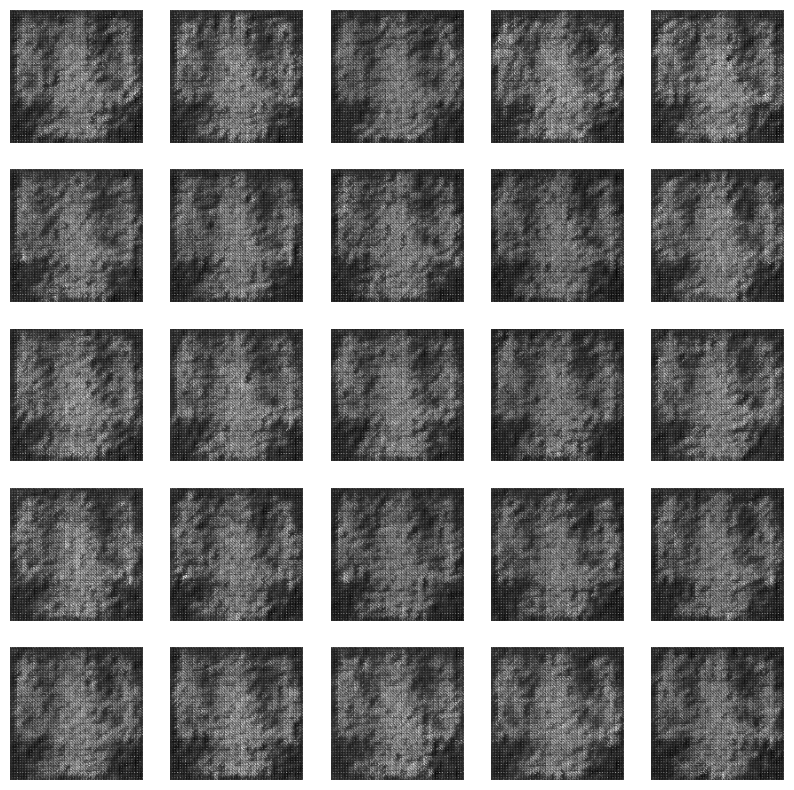

Epoch 11, Disc loss 0.16337651607724032, Generator loss 0.001174087299053402
Epoch 12, Disc loss 0.16473757842716927, Generator loss 0.0013913764123572037
Epoch 13, Disc loss 0.1632780017727858, Generator loss 0.001563121169359268
Epoch 14, Disc loss 0.16326467694686167, Generator loss 0.0028611236242189384
Epoch 15, Disc loss 2.146111748488263, Generator loss 13.576156282118367
Epoch 16, Disc loss 0.21259225828301473, Generator loss 9.519434173901876
Epoch 17, Disc loss 0.23807021036433676, Generator loss 8.402465641498566
Epoch 18, Disc loss 0.31644077273085713, Generator loss 6.7561395565668745
Epoch 19, Disc loss 0.33709136908873916, Generator loss 5.095402767260869
Epoch 20, Disc loss 0.3790053596409659, Generator loss 3.857035756111145
1/1 [==============================] - 0s 20ms/step


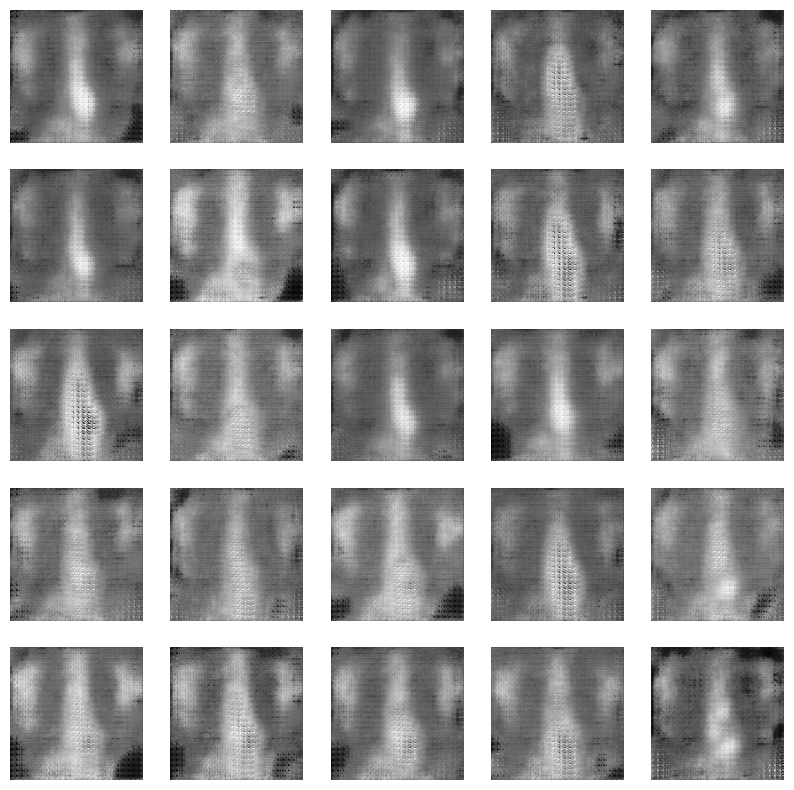

Epoch 21, Disc loss 0.39984036702662706, Generator loss 3.4817906518777213
Epoch 22, Disc loss 0.416129147944351, Generator loss 3.521863132715225
Epoch 23, Disc loss 0.5030698239182433, Generator loss 3.043951948483785
Epoch 24, Disc loss 0.5199187515924374, Generator loss 2.7250248988469443
Epoch 25, Disc loss 0.555357662960887, Generator loss 2.7198141713937125
Epoch 26, Disc loss 0.6759551043311754, Generator loss 1.9970368792613347
Epoch 27, Disc loss 0.6811565806468328, Generator loss 1.6421516487995784
Epoch 28, Disc loss 0.7030938391884168, Generator loss 1.4355940371751785
Epoch 29, Disc loss 0.7128868103027344, Generator loss 1.3120196262995403
Epoch 30, Disc loss 0.7180897171298662, Generator loss 1.2390701274077098
1/1 [==============================] - 0s 23ms/step


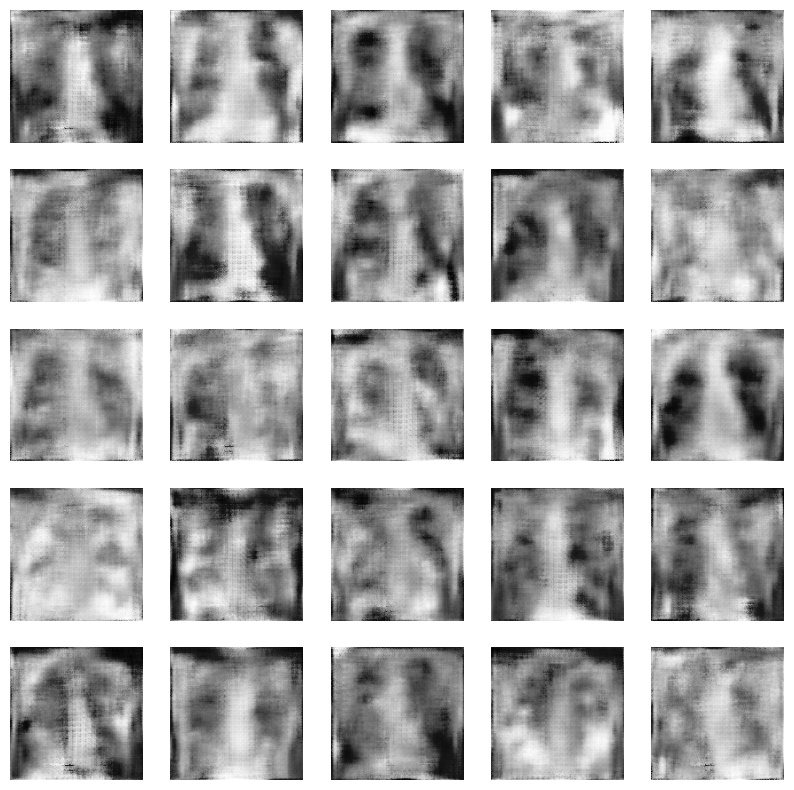

Epoch 31, Disc loss 0.7038522387544314, Generator loss 1.1772490888834
Epoch 32, Disc loss 0.6747186134258906, Generator loss 1.1717986265818279
Epoch 33, Disc loss 0.6644354748229185, Generator loss 1.1796810080607731
Epoch 34, Disc loss 0.667975228279829, Generator loss 1.1516889135042827
Epoch 35, Disc loss 0.6629353103538355, Generator loss 1.1679590543111165
Epoch 36, Disc loss 0.6559966318309307, Generator loss 1.1593249042828877
Epoch 37, Disc loss 0.6574922452370325, Generator loss 1.1688193877538045
Epoch 38, Disc loss 0.6589733411868414, Generator loss 1.1516960362593334
Epoch 39, Disc loss 0.6535743537048498, Generator loss 1.1599652667840321
Epoch 40, Disc loss 0.6485046905775865, Generator loss 1.163110613822937
1/1 [==============================] - 0s 21ms/step


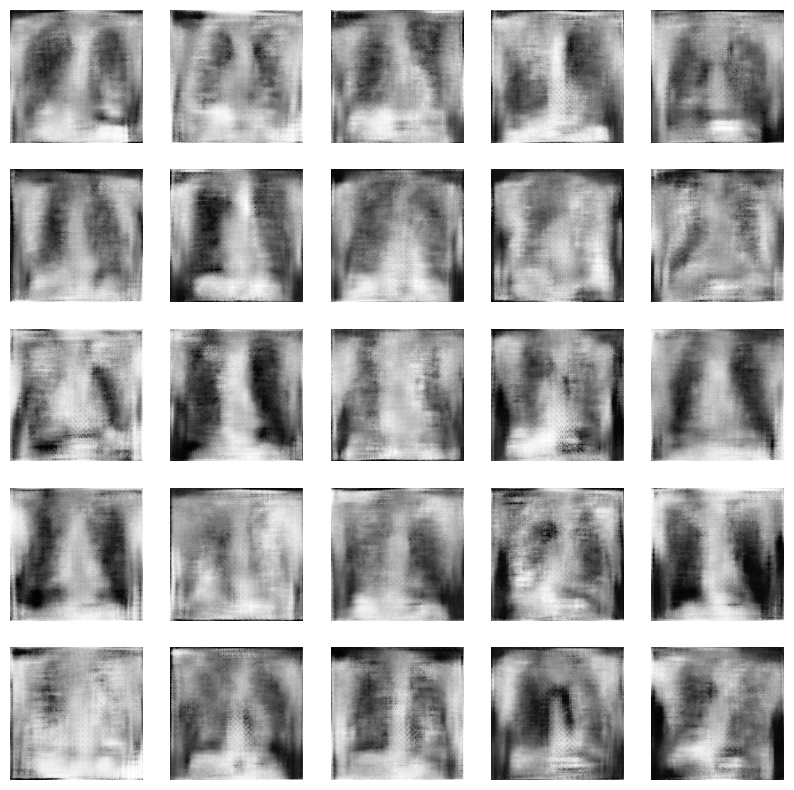

Epoch 41, Disc loss 0.6493426263332367, Generator loss 1.1723661373058956
Epoch 42, Disc loss 0.6432502927879492, Generator loss 1.1952297240495682
Epoch 43, Disc loss 0.6361138584713141, Generator loss 1.2037986367940903
Epoch 44, Disc loss 0.641411247352759, Generator loss 1.2037306825319927
Epoch 45, Disc loss 0.6331664224465688, Generator loss 1.195552483201027
Epoch 46, Disc loss 0.6321426834911108, Generator loss 1.2120187878608704
Epoch 47, Disc loss 0.6290634466956059, Generator loss 1.2133760005235672
Epoch 48, Disc loss 0.6262183133512735, Generator loss 1.2265999913215637
Epoch 49, Disc loss 0.6258963110546271, Generator loss 1.2423274219036102
Epoch 50, Disc loss 0.6202246074875196, Generator loss 1.2415365129709244
1/1 [==============================] - 0s 33ms/step


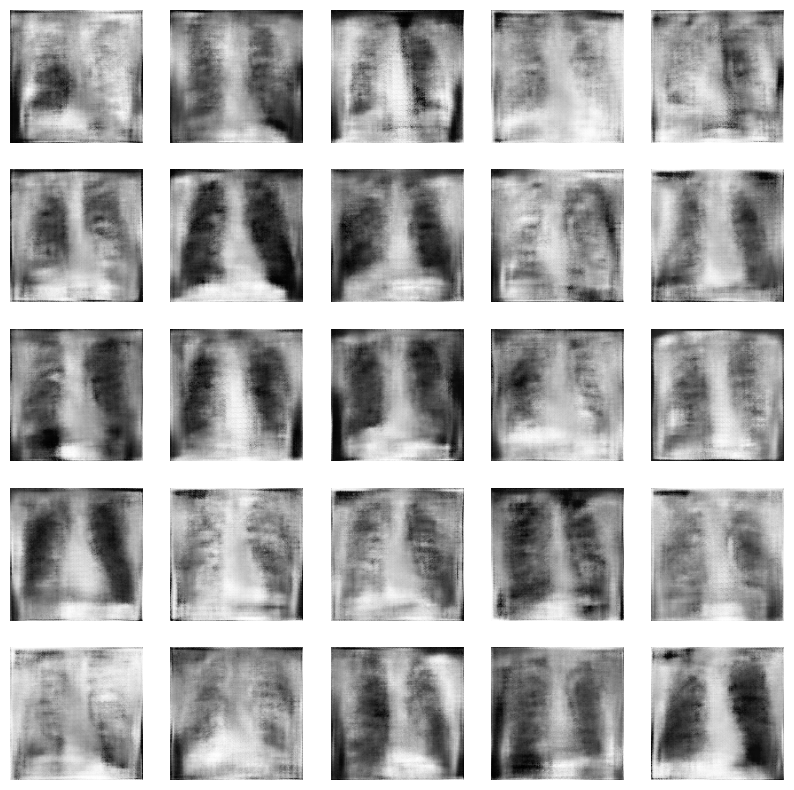

Epoch 51, Disc loss 0.6242741284271082, Generator loss 1.2458885063727696
Epoch 52, Disc loss 0.6200647292037805, Generator loss 1.250344877441724
Epoch 53, Disc loss 0.6174323875457048, Generator loss 1.2577592929204304
Epoch 54, Disc loss 0.6142824031412601, Generator loss 1.2826486279567082
Epoch 55, Disc loss 0.6099887533734242, Generator loss 1.2851274112860362
Epoch 56, Disc loss 0.6124973800033331, Generator loss 1.2913987437884014
Epoch 57, Disc loss 0.6087528889377912, Generator loss 1.3244247535864513
Epoch 58, Disc loss 0.600598705932498, Generator loss 1.3320785214503605
Epoch 59, Disc loss 0.597702927266558, Generator loss 1.3448716153701146
Epoch 60, Disc loss 0.5911439154297113, Generator loss 1.3609554370244343
1/1 [==============================] - 0s 21ms/step


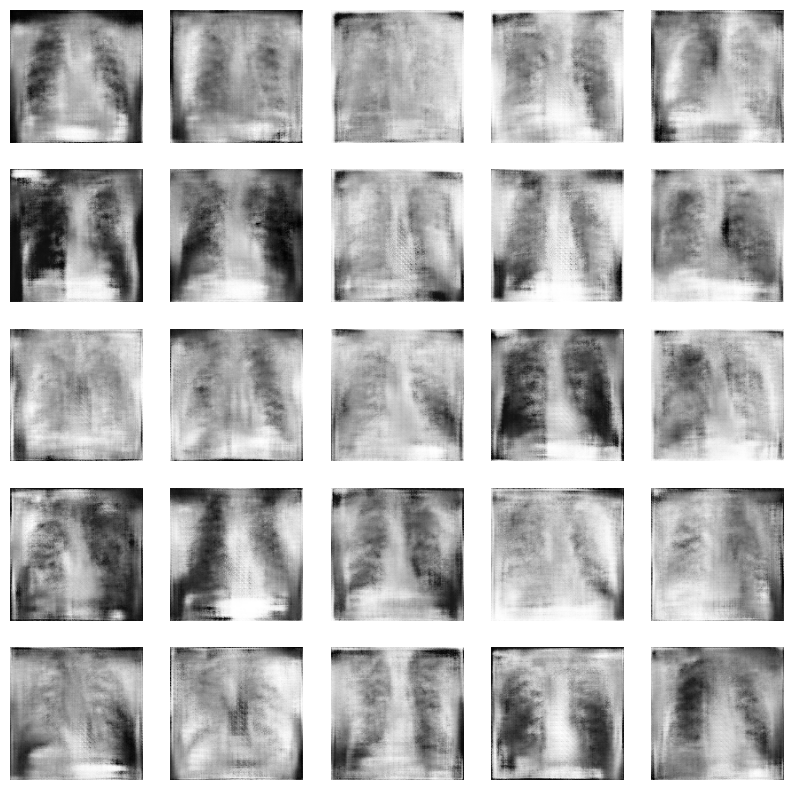

Epoch 61, Disc loss 0.5920490982631842, Generator loss 1.3660171280304592
Epoch 62, Disc loss 0.5794789356489977, Generator loss 1.3841009984413783
Epoch 63, Disc loss 0.5899730076392492, Generator loss 1.394968296090762
Epoch 64, Disc loss 0.5806104298681021, Generator loss 1.4313402275244396
Epoch 65, Disc loss 0.573266368980209, Generator loss 1.4329385409752529
Epoch 66, Disc loss 0.5721803599347671, Generator loss 1.4472201814254124
Epoch 67, Disc loss 0.575646527732412, Generator loss 1.4713938037554424
Epoch 68, Disc loss 0.5660969130694866, Generator loss 1.4823454717795055
Epoch 69, Disc loss 0.5719308312982321, Generator loss 1.4772857278585434
Epoch 70, Disc loss 0.5653214411189159, Generator loss 1.4978620956341426
1/1 [==============================] - 0s 22ms/step


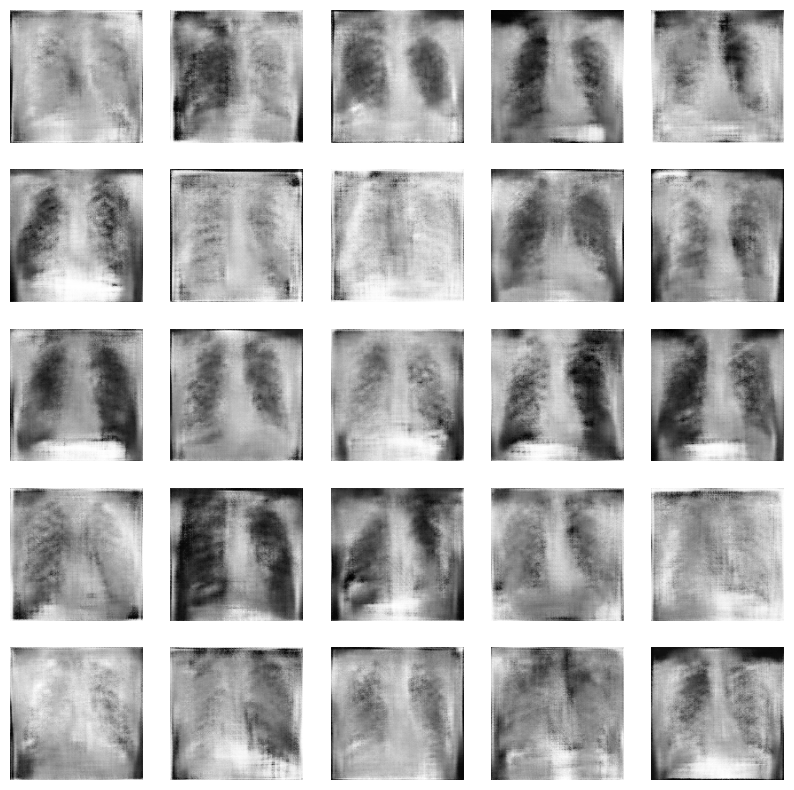

Epoch 71, Disc loss 0.5551664102822542, Generator loss 1.519311209519704
Epoch 72, Disc loss 0.5565417632460594, Generator loss 1.5299104501803715
Epoch 73, Disc loss 0.5491190236061811, Generator loss 1.532635822892189
Epoch 74, Disc loss 0.5380402927597364, Generator loss 1.5931465526421864
Epoch 75, Disc loss 0.5369211863726377, Generator loss 1.6209556261698406
Epoch 76, Disc loss 0.5403004915763935, Generator loss 1.6075752427180607
Epoch 77, Disc loss 0.5273345528791348, Generator loss 1.6549016882975895
Epoch 78, Disc loss 0.5260991224398216, Generator loss 1.6432042469580967
Epoch 79, Disc loss 0.5155419952546557, Generator loss 1.679090787967046
Epoch 80, Disc loss 0.5190349854528904, Generator loss 1.6948076883951824
1/1 [==============================] - 0s 18ms/step


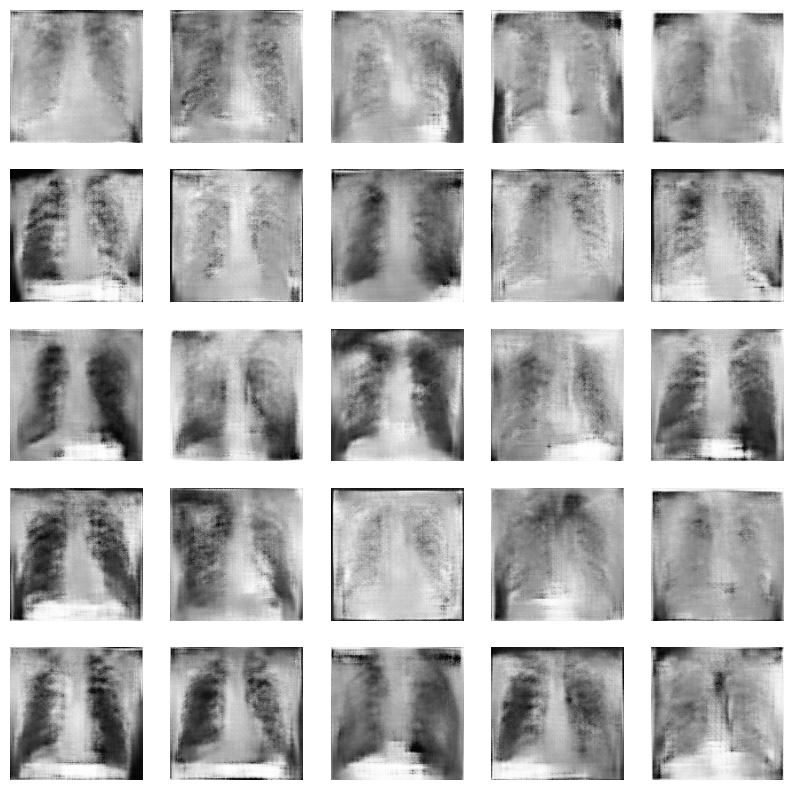

Epoch 81, Disc loss 0.5056471036126217, Generator loss 1.7383036762475967
Epoch 82, Disc loss 0.5091574167211851, Generator loss 1.710167869925499
Epoch 83, Disc loss 0.501511895408233, Generator loss 1.7481547842423122
Epoch 84, Disc loss 0.4880684573824207, Generator loss 1.8287483602762222
Epoch 85, Disc loss 0.5022636086990436, Generator loss 1.7662347108125687
Epoch 86, Disc loss 0.4942224596937497, Generator loss 1.7939983308315277
Epoch 87, Disc loss 0.4768076005081336, Generator loss 1.8507702102263768
Epoch 88, Disc loss 0.48334019786367816, Generator loss 1.8739952792723973
Epoch 89, Disc loss 0.47889481236537296, Generator loss 1.8660201877355576
Epoch 90, Disc loss 0.46772206171105307, Generator loss 1.915320411324501
1/1 [==============================] - 0s 19ms/step


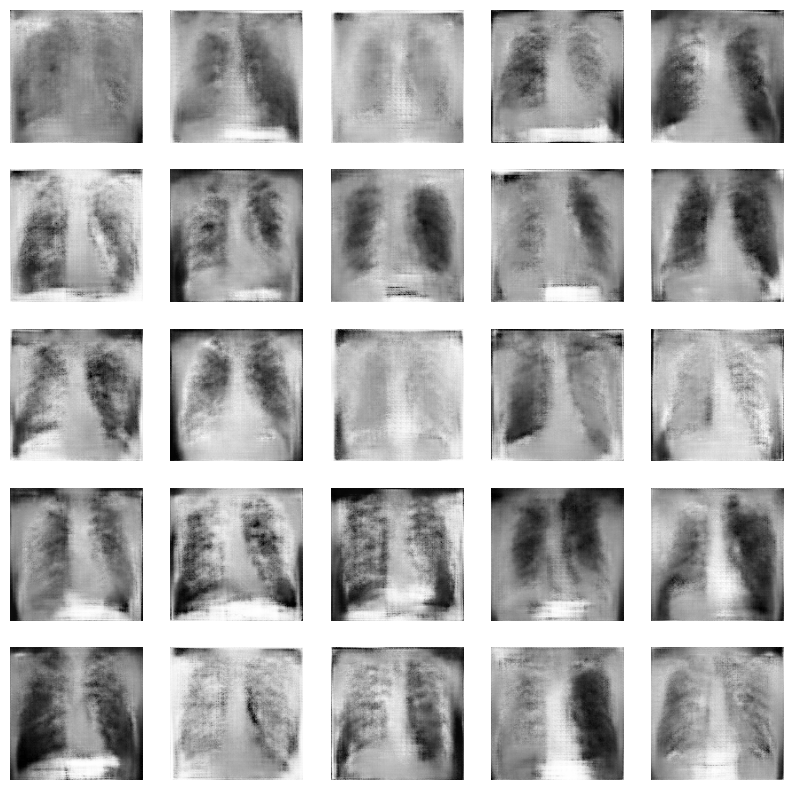

Epoch 91, Disc loss 0.4675519863764445, Generator loss 1.924674501021703
Epoch 92, Disc loss 0.4722299749652545, Generator loss 1.9319688429435093
Epoch 93, Disc loss 0.4667287804186344, Generator loss 1.9174516846736271
Epoch 94, Disc loss 0.4616247757027547, Generator loss 1.952442263563474
Epoch 95, Disc loss 0.46318707304696244, Generator loss 1.9662927240133286
Epoch 96, Disc loss 0.4585468949129184, Generator loss 2.0093153715133667
Epoch 97, Disc loss 0.46317115270843107, Generator loss 1.9916734049717586
Epoch 98, Disc loss 0.4500391936550538, Generator loss 2.0676064093907676
Epoch 99, Disc loss 0.4491540581608812, Generator loss 2.0289935817321143
Epoch 100, Disc loss 0.43694276300569374, Generator loss 2.1238586554924646
1/1 [==============================] - 0s 19ms/step


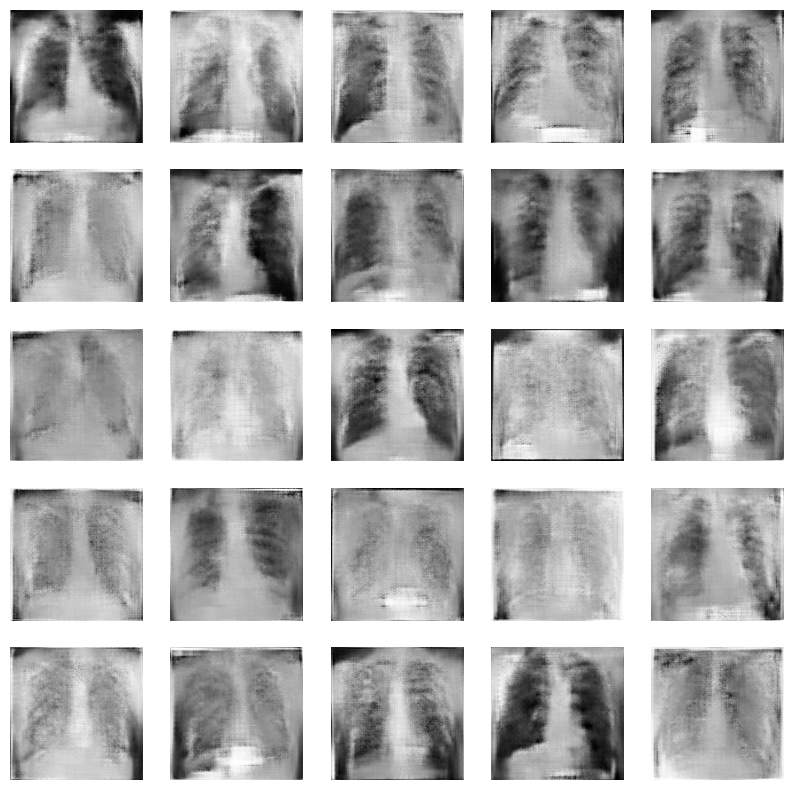

Epoch 101, Disc loss 0.4309430706004302, Generator loss 2.133354033033053
Epoch 102, Disc loss 0.4383948150401314, Generator loss 2.155309870839119
Epoch 103, Disc loss 0.4336824680988987, Generator loss 2.157677635550499
Epoch 104, Disc loss 0.43394340109080076, Generator loss 2.144373377164205
Epoch 105, Disc loss 0.41398834250867367, Generator loss 2.2082192798455558
Epoch 106, Disc loss 0.4256099335228403, Generator loss 2.217290778954824
Epoch 107, Disc loss 0.412257590641578, Generator loss 2.234393243988355
Epoch 108, Disc loss 0.40509076913197833, Generator loss 2.310129478573799
Epoch 109, Disc loss 0.43256216154744226, Generator loss 2.2772336502869925
Epoch 110, Disc loss 0.4182101308057706, Generator loss 2.308243120710055
1/1 [==============================] - 0s 21ms/step


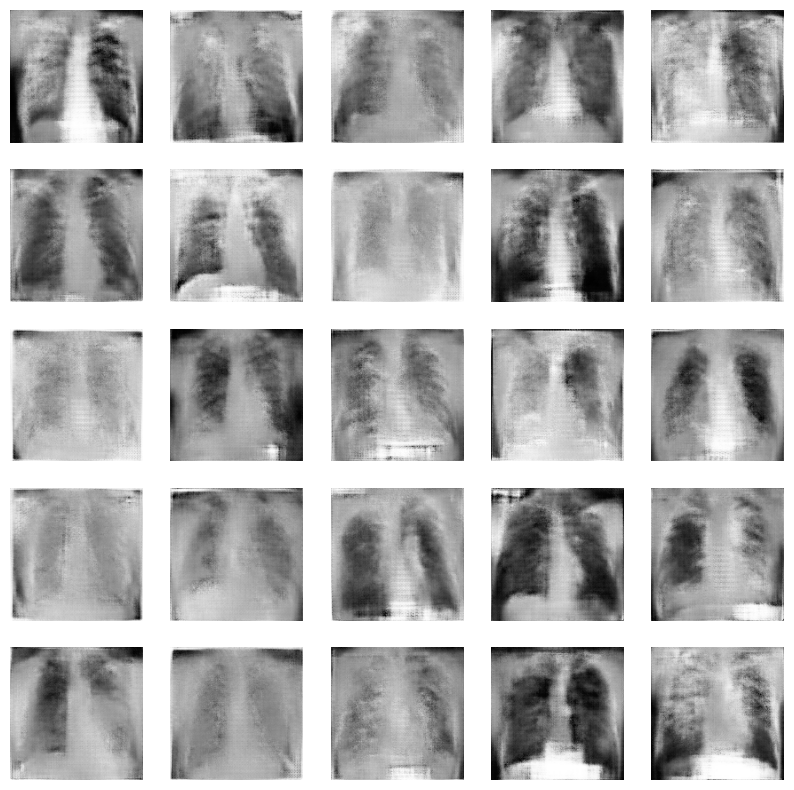

Epoch 111, Disc loss 0.3993313383931915, Generator loss 2.3721400996049247
Epoch 112, Disc loss 0.42043673278143007, Generator loss 2.3744587302207947
Epoch 113, Disc loss 0.3898406686882178, Generator loss 2.3648089170455933
Epoch 114, Disc loss 0.4090600811565916, Generator loss 2.406051536401113
Epoch 115, Disc loss 0.38940388585130375, Generator loss 2.416029920180639
Epoch 116, Disc loss 0.3961139274761081, Generator loss 2.4216708838939667
Epoch 117, Disc loss 0.3962236015746991, Generator loss 2.4420859615008035
Epoch 118, Disc loss 0.39952999881158274, Generator loss 2.4873825013637543
Epoch 119, Disc loss 0.39087007970859605, Generator loss 2.5079124669233956
Epoch 120, Disc loss 0.3668564821903904, Generator loss 2.4782790541648865
1/1 [==============================] - 0s 21ms/step


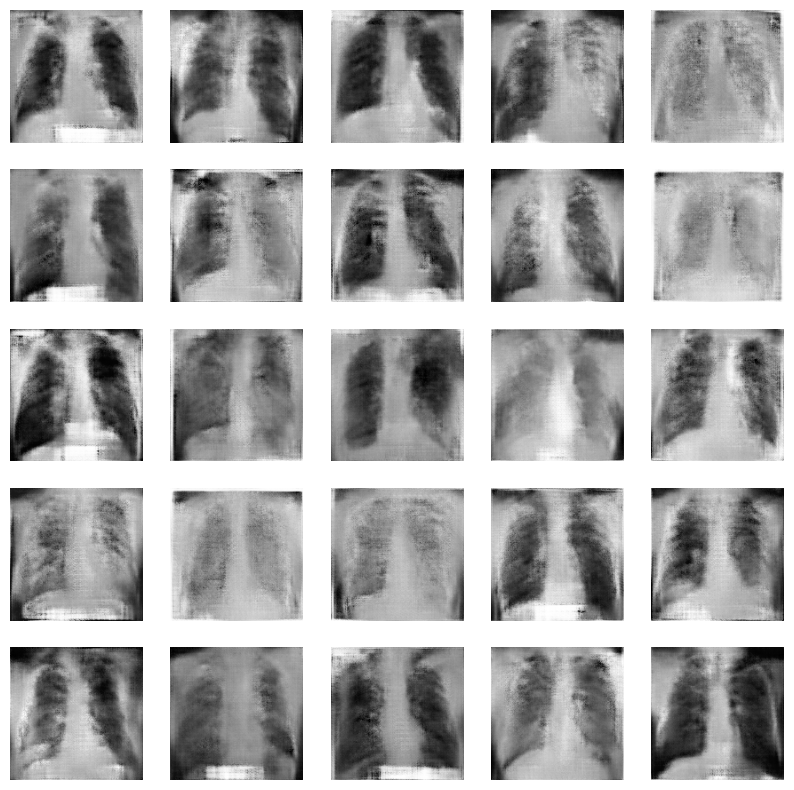

Epoch 121, Disc loss 0.38861808615426224, Generator loss 2.5641426841417947
Epoch 122, Disc loss 0.3652459206059575, Generator loss 2.5371668537457785
Epoch 123, Disc loss 0.36528498275826377, Generator loss 2.5869318346182504
Epoch 124, Disc loss 0.373751708616813, Generator loss 2.596347043911616
Epoch 125, Disc loss 0.3644437588130434, Generator loss 2.643289844195048
Epoch 126, Disc loss 0.3878991377229492, Generator loss 2.609615981578827
Epoch 127, Disc loss 0.37447013643880683, Generator loss 2.6599538326263428
Epoch 128, Disc loss 0.3656599661335349, Generator loss 2.6261787712574005
Epoch 129, Disc loss 0.3681435901671648, Generator loss 2.6503796180089316
Epoch 130, Disc loss 0.3806928902243574, Generator loss 2.721648782491684
1/1 [==============================] - 0s 23ms/step


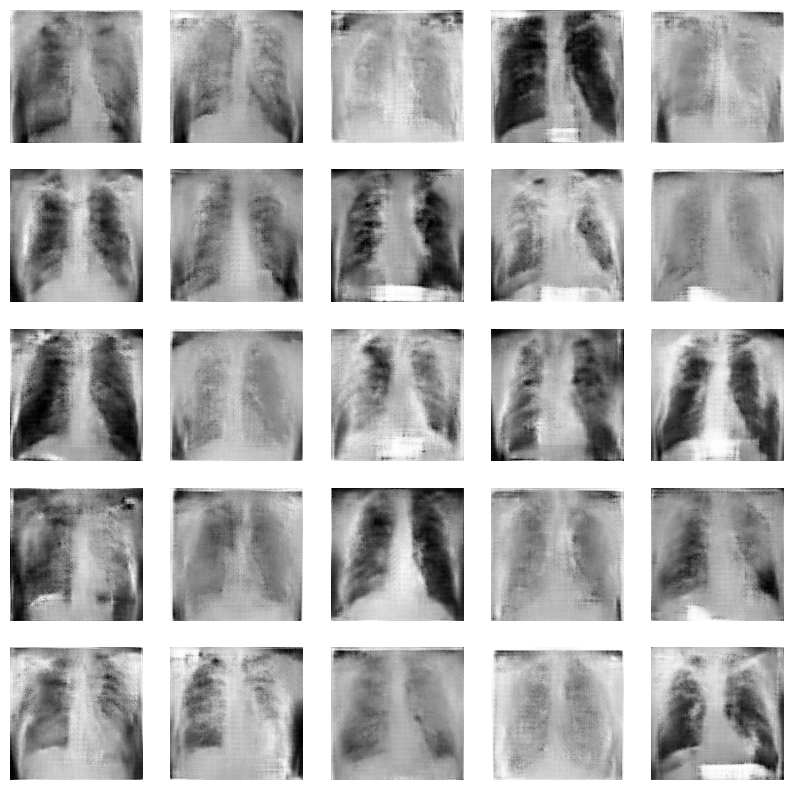

Epoch 131, Disc loss 0.3568870259138445, Generator loss 2.69483091433843
Epoch 132, Disc loss 0.35069737226391834, Generator loss 2.7650814155737558
Epoch 133, Disc loss 0.357459905402114, Generator loss 2.744412829478582
Epoch 134, Disc loss 0.36875220605482656, Generator loss 2.7325133283933005
Epoch 135, Disc loss 0.35644774076839286, Generator loss 2.7740817864735923
Epoch 136, Disc loss 0.32690563704818487, Generator loss 2.8315002818902335
Epoch 137, Disc loss 0.41836082252363366, Generator loss 2.8872356017430625
Epoch 138, Disc loss 0.34043892348806065, Generator loss 2.809117724498113
Epoch 139, Disc loss 0.33802537821854156, Generator loss 2.86127300063769
Epoch 140, Disc loss 0.3252036234674354, Generator loss 2.8925026754538217
1/1 [==============================] - 0s 22ms/step


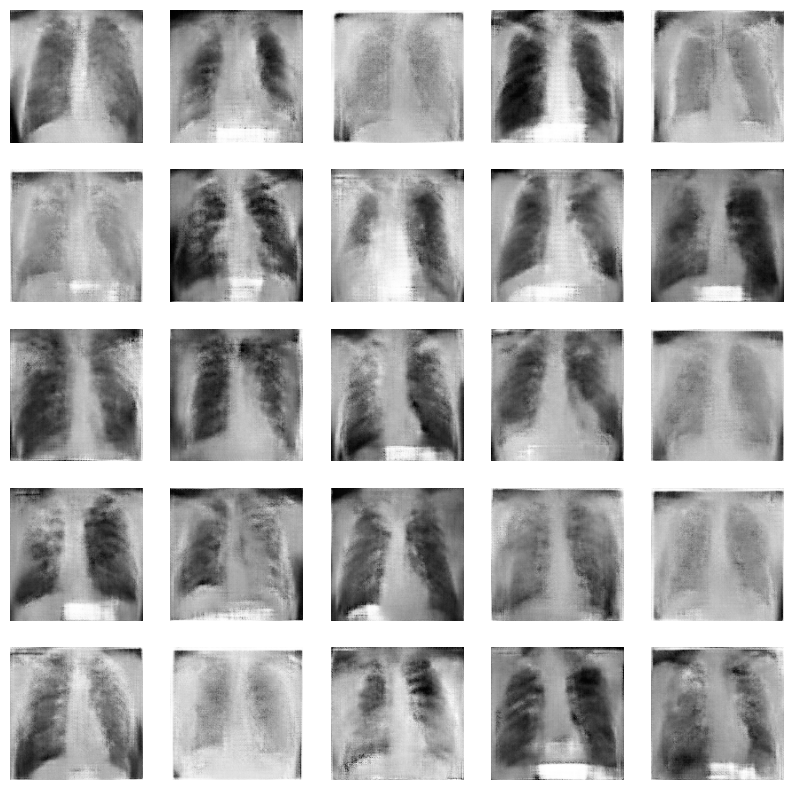

Epoch 141, Disc loss 0.3338842418355246, Generator loss 2.891343593597412
Epoch 142, Disc loss 0.33587316951404017, Generator loss 2.942390670379003
Epoch 143, Disc loss 0.32256622922917205, Generator loss 2.9284761448701224
Epoch 144, Disc loss 0.3433264566895862, Generator loss 2.936504691839218
Epoch 145, Disc loss 0.31853485681737465, Generator loss 3.042976270119349
Epoch 146, Disc loss 0.3219600723435481, Generator loss 3.0915211041768393
Epoch 147, Disc loss 0.3681040513329208, Generator loss 3.04298863808314
Epoch 148, Disc loss 0.32041270518675447, Generator loss 2.9718648393948874
Epoch 149, Disc loss 0.34133875168239075, Generator loss 3.025923321644465
Epoch 150, Disc loss 0.31656211459388334, Generator loss 3.0850543777147927
1/1 [==============================] - 0s 33ms/step


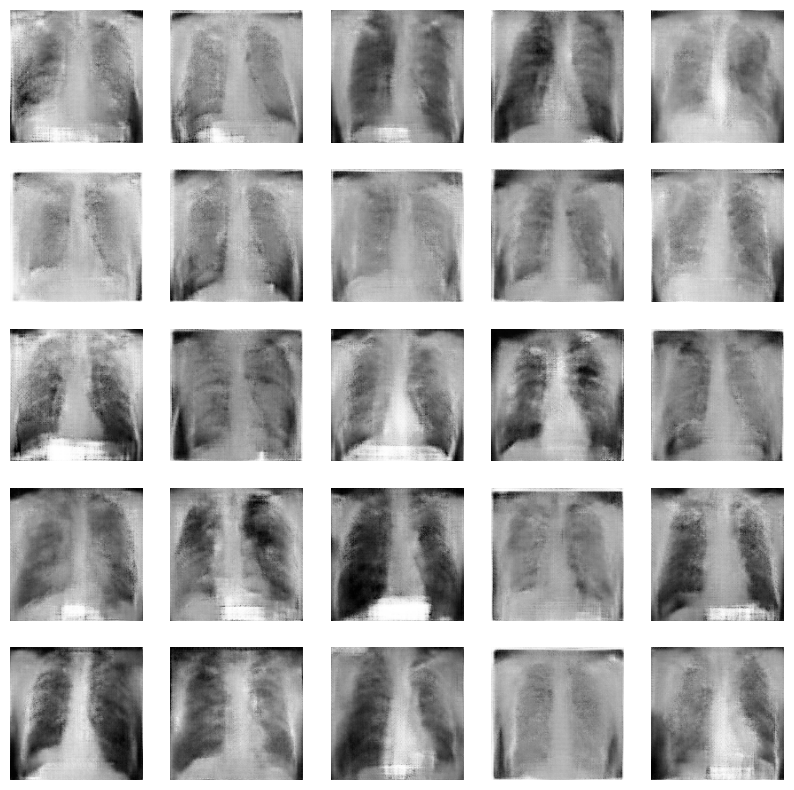

Epoch 151, Disc loss 0.3195613780990243, Generator loss 3.0889916320641837
Epoch 152, Disc loss 0.29794887779280543, Generator loss 3.151671379804611
Epoch 153, Disc loss 0.30866028973832726, Generator loss 3.175306091705958
Epoch 154, Disc loss 0.3055055271834135, Generator loss 3.240020672480265
Epoch 155, Disc loss 0.31890037733440596, Generator loss 3.2193289399147034
Epoch 156, Disc loss 0.28317011691009003, Generator loss 3.3596430718898773
Epoch 157, Disc loss 0.3177599537496765, Generator loss 3.230405479669571
Epoch 158, Disc loss 0.29412831164275605, Generator loss 3.256898432970047
Epoch 159, Disc loss 0.30281145793075365, Generator loss 3.2629354993502298
Epoch 160, Disc loss 0.27824986376799643, Generator loss 3.355476369460424
1/1 [==============================] - 0s 20ms/step


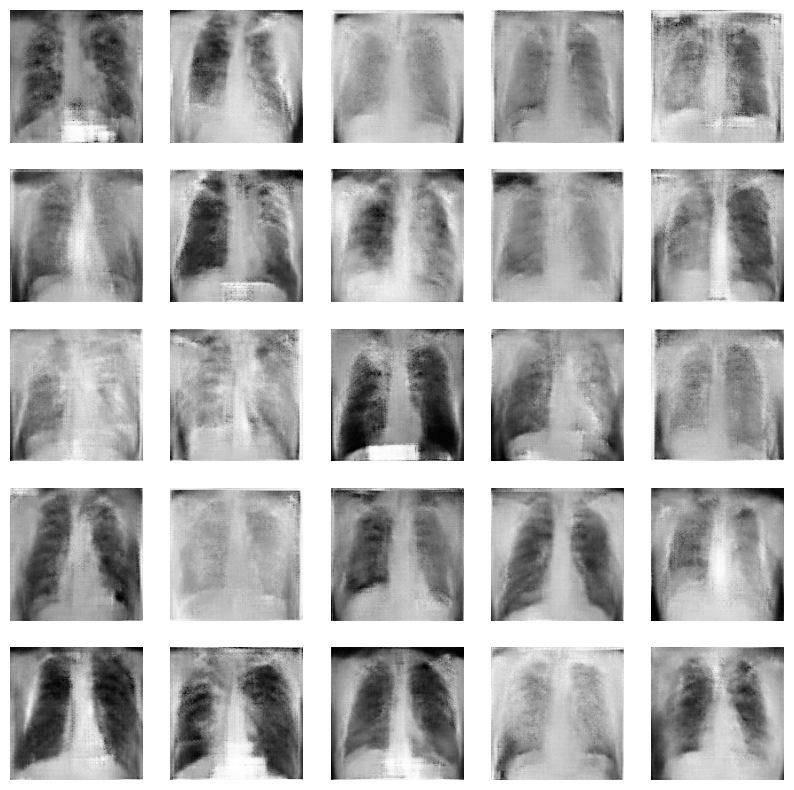

Epoch 161, Disc loss 0.3165139025077224, Generator loss 3.348237305879593
Epoch 162, Disc loss 0.2943077345068256, Generator loss 3.3954935570557914
Epoch 163, Disc loss 0.3021568777039647, Generator loss 3.3676563501358032
Epoch 164, Disc loss 0.297849756355087, Generator loss 3.3372022906939187
Epoch 165, Disc loss 0.2885138934167723, Generator loss 3.4552791019280753
Epoch 166, Disc loss 0.28611459226037067, Generator loss 3.444278041521708
Epoch 167, Disc loss 0.28301941727598506, Generator loss 3.4728661676247916
Epoch 168, Disc loss 0.28473575972020626, Generator loss 3.4709691305955253
Epoch 169, Disc loss 0.2870202912017703, Generator loss 3.525842070579529
Epoch 170, Disc loss 0.3062437482488652, Generator loss 3.5543198784192405
1/1 [==============================] - 0s 25ms/step


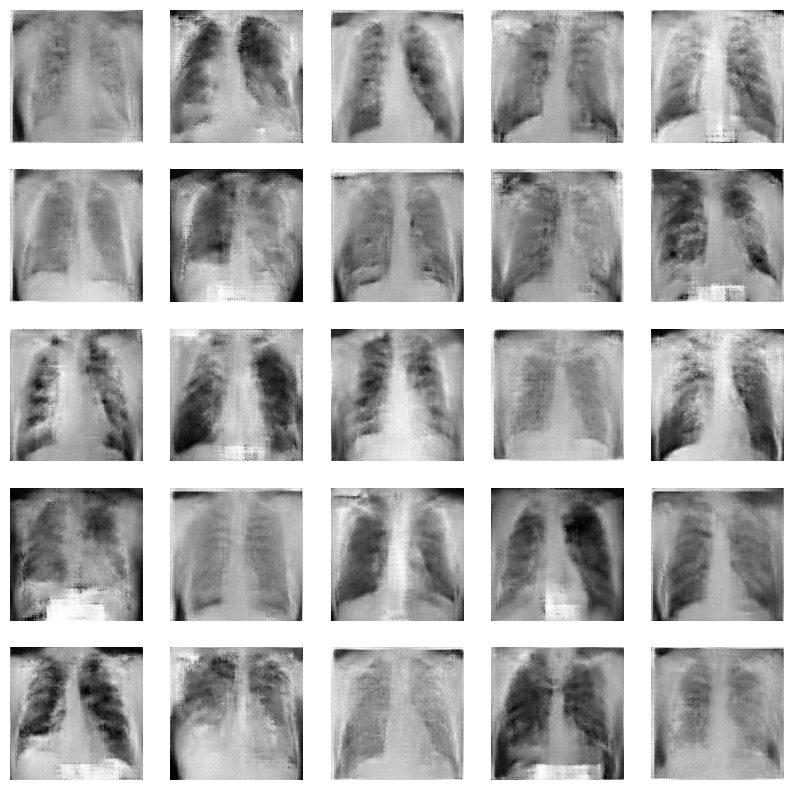

Epoch 171, Disc loss 0.296959669329226, Generator loss 3.5057451327641806
Epoch 172, Disc loss 0.27227283525280654, Generator loss 3.557703157265981
Epoch 173, Disc loss 4.601287642988609, Generator loss 3.812675889271001
Epoch 174, Disc loss 0.7182741425931454, Generator loss 1.8637674103180568
Epoch 175, Disc loss 0.5908187596748272, Generator loss 1.8510443568229675
Epoch 176, Disc loss 0.48884854931384325, Generator loss 1.9906604637702305
Epoch 177, Disc loss 0.4491373347118497, Generator loss 2.070851430296898
Epoch 178, Disc loss 0.40805008231351775, Generator loss 2.179510469237963
Epoch 179, Disc loss 0.37708796622852486, Generator loss 2.324145257472992
Epoch 180, Disc loss 0.354264996945858, Generator loss 2.4258578519026437
1/1 [==============================] - 0s 22ms/step


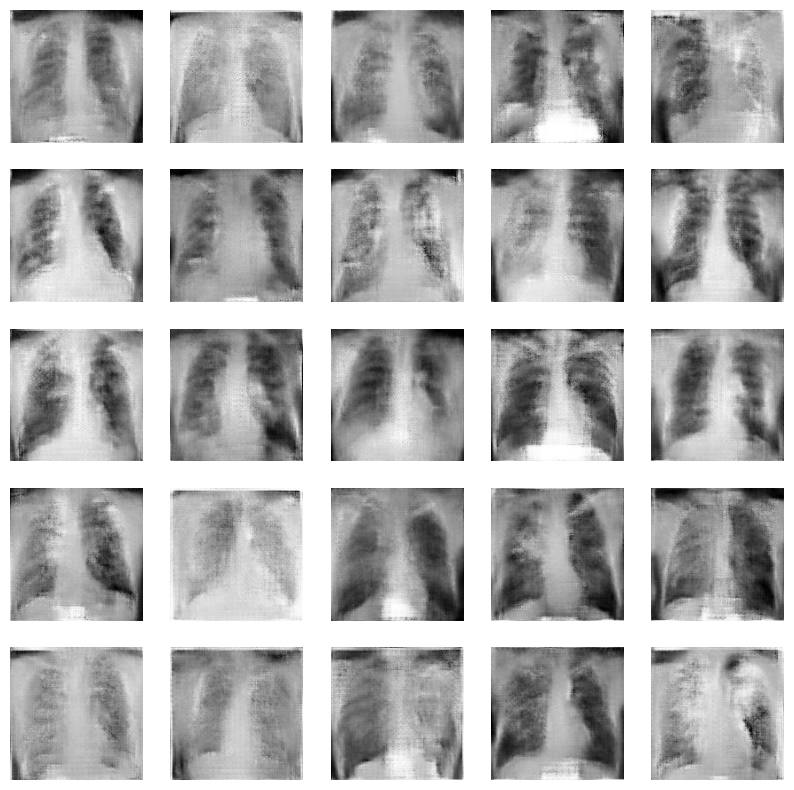

Epoch 181, Disc loss 0.3317836293329795, Generator loss 2.4819574455420175
Epoch 182, Disc loss 0.33183572844912607, Generator loss 2.55942510565122
Epoch 183, Disc loss 0.31609287671744823, Generator loss 2.6253741880257926
Epoch 184, Disc loss 0.3171451861659686, Generator loss 2.645433326562246
Epoch 185, Disc loss 0.3012461275793612, Generator loss 2.7462880412737527
Epoch 186, Disc loss 0.3012956287711859, Generator loss 2.7567242681980133
Epoch 187, Disc loss 0.2890103426761925, Generator loss 2.819366147120794
Epoch 188, Disc loss 0.28755114289621514, Generator loss 2.9189435640970864
Epoch 189, Disc loss 0.2872074726037681, Generator loss 2.9235814412434897
Epoch 190, Disc loss 0.2899175177638729, Generator loss 2.9498804608980813
1/1 [==============================] - 0s 22ms/step


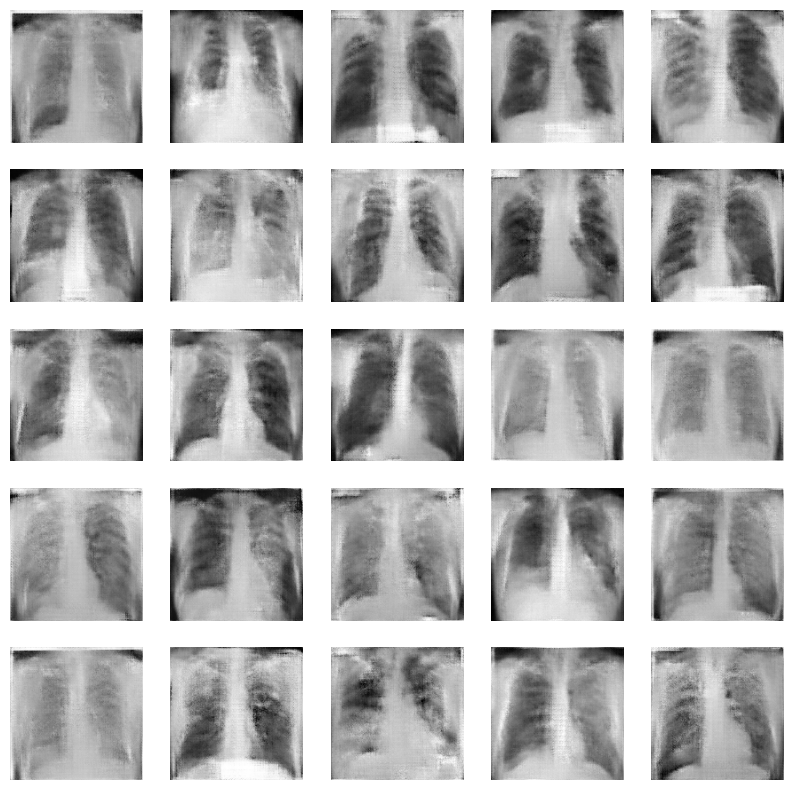

Epoch 191, Disc loss 0.2732249322968225, Generator loss 3.016669342915217
Epoch 192, Disc loss 0.28132279434551793, Generator loss 2.937410891056061
Epoch 193, Disc loss 0.2726113338333865, Generator loss 3.0769745806852975
Epoch 194, Disc loss 0.2783924404842158, Generator loss 3.068565954764684
Epoch 195, Disc loss 0.27084107386569184, Generator loss 3.103001912434896
Epoch 196, Disc loss 0.27889864674458903, Generator loss 3.1207854449748993
Epoch 197, Disc loss 0.2751845014281571, Generator loss 3.1096112529436746
Epoch 198, Disc loss 0.2709310877447327, Generator loss 3.146759102741877
Epoch 199, Disc loss 0.26749813921439153, Generator loss 3.1605193614959717
Epoch 200, Disc loss 0.273323608096689, Generator loss 3.2285407284895578
1/1 [==============================] - 0s 23ms/step


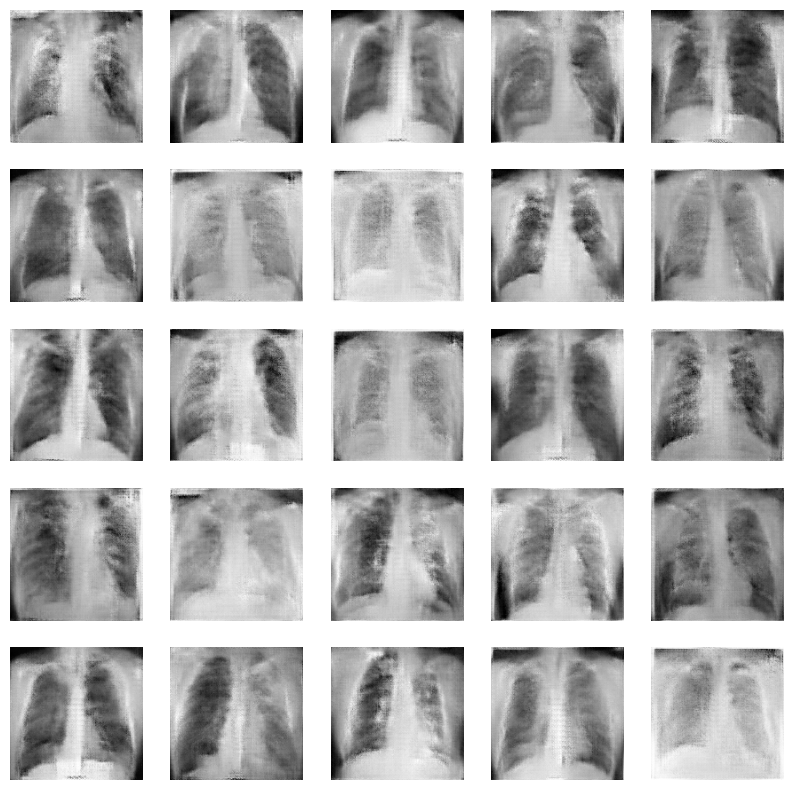

Epoch 201, Disc loss 0.27489594199384254, Generator loss 3.194371908903122
Epoch 202, Disc loss 0.2623374645287792, Generator loss 3.2863242626190186
Epoch 203, Disc loss 0.27205703943036497, Generator loss 3.2290362219015756
Epoch 204, Disc loss 0.26292491517961025, Generator loss 3.3094654381275177
Epoch 205, Disc loss 0.2664842971911033, Generator loss 3.326054185628891
Epoch 206, Disc loss 0.26269959565252066, Generator loss 3.350012093782425
Epoch 207, Disc loss 0.2652306448823462, Generator loss 3.2824774781862893
Epoch 208, Disc loss 0.26476404955610633, Generator loss 3.33519317706426
Epoch 209, Disc loss 0.26755957941835123, Generator loss 3.3356552024682364
Epoch 210, Disc loss 0.261964309339722, Generator loss 3.4161646564801535
1/1 [==============================] - 0s 33ms/step


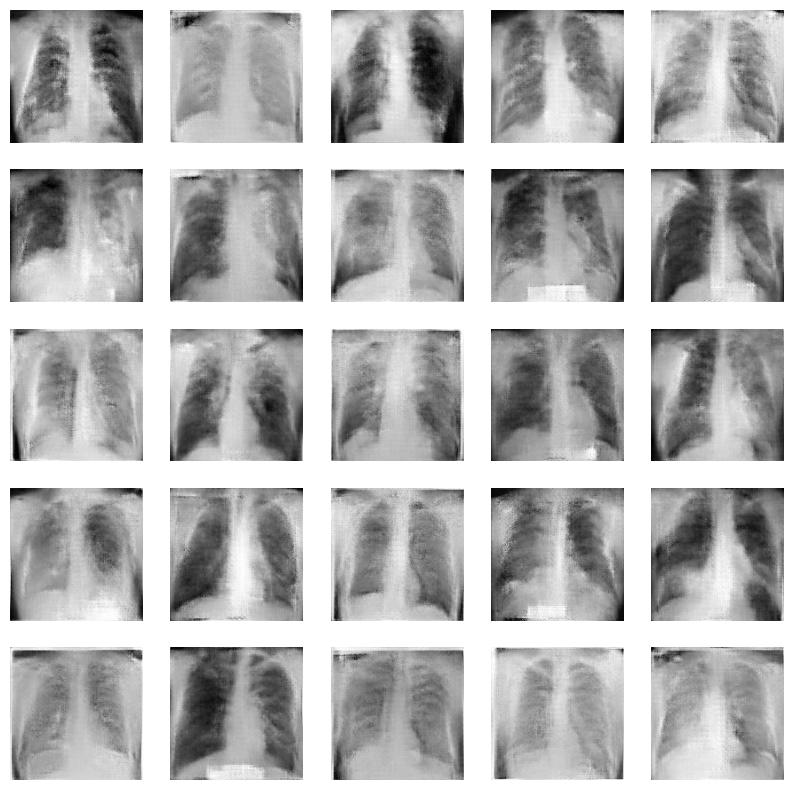

Epoch 211, Disc loss 0.2750207686331123, Generator loss 3.423799455165863
Epoch 212, Disc loss 0.25692485831677914, Generator loss 3.352120359738668
Epoch 213, Disc loss 0.25988956276948255, Generator loss 3.48221563299497
Epoch 214, Disc loss 0.25895996803107363, Generator loss 3.51320680975914
Epoch 215, Disc loss 0.2728024950871865, Generator loss 3.406416336695353
Epoch 216, Disc loss 0.25501169194467366, Generator loss 3.565516104300817
Epoch 217, Disc loss 0.2503671386123945, Generator loss 3.5191319783528647
Epoch 218, Disc loss 0.25099944113753736, Generator loss 3.5868713557720184
Epoch 219, Disc loss 0.26185990621646243, Generator loss 3.575092226266861
Epoch 220, Disc loss 0.2992117232643068, Generator loss 3.4842579464117684
1/1 [==============================] - 0s 20ms/step


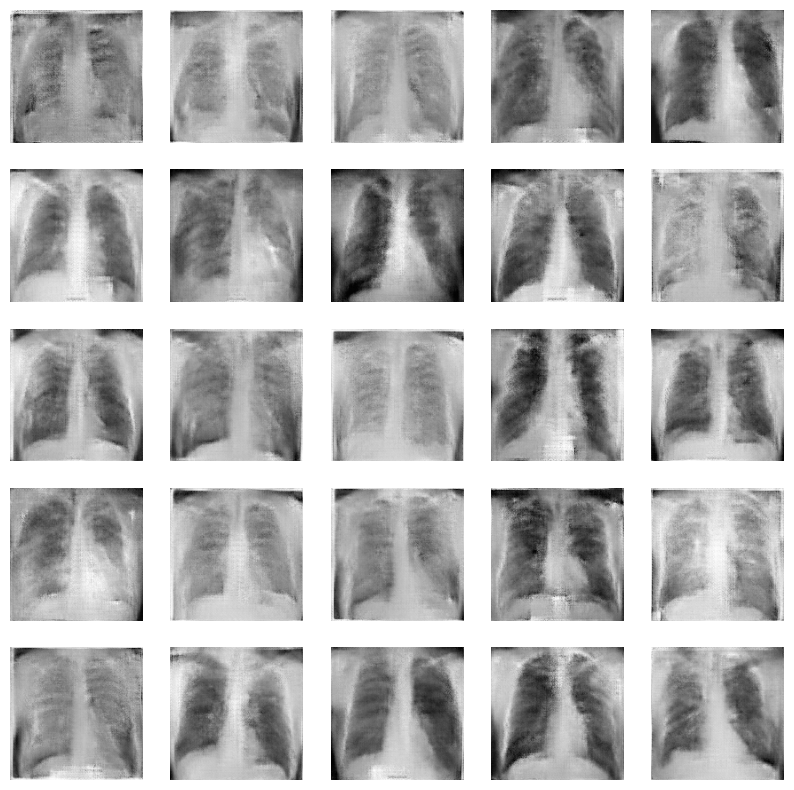

Epoch 221, Disc loss 0.27285132673569024, Generator loss 3.5326805313428244
Epoch 222, Disc loss 0.26802339653174084, Generator loss 3.4622606337070465
Epoch 223, Disc loss 0.25357634069708485, Generator loss 3.5482221047083535
Epoch 224, Disc loss 0.2564603271118055, Generator loss 3.646687706311544
Epoch 225, Disc loss 0.2662088859360665, Generator loss 3.5872761408487954
Epoch 226, Disc loss 0.25205982166032, Generator loss 3.6647021075089774
Epoch 227, Disc loss 0.25578123788970214, Generator loss 3.6377702752749124
Epoch 228, Disc loss 0.24379769968800247, Generator loss 3.735396832227707
Epoch 229, Disc loss 0.2758371884313722, Generator loss 3.7498423159122467
Epoch 230, Disc loss 0.2808657775943478, Generator loss 3.595544695854187
1/1 [==============================] - 0s 20ms/step


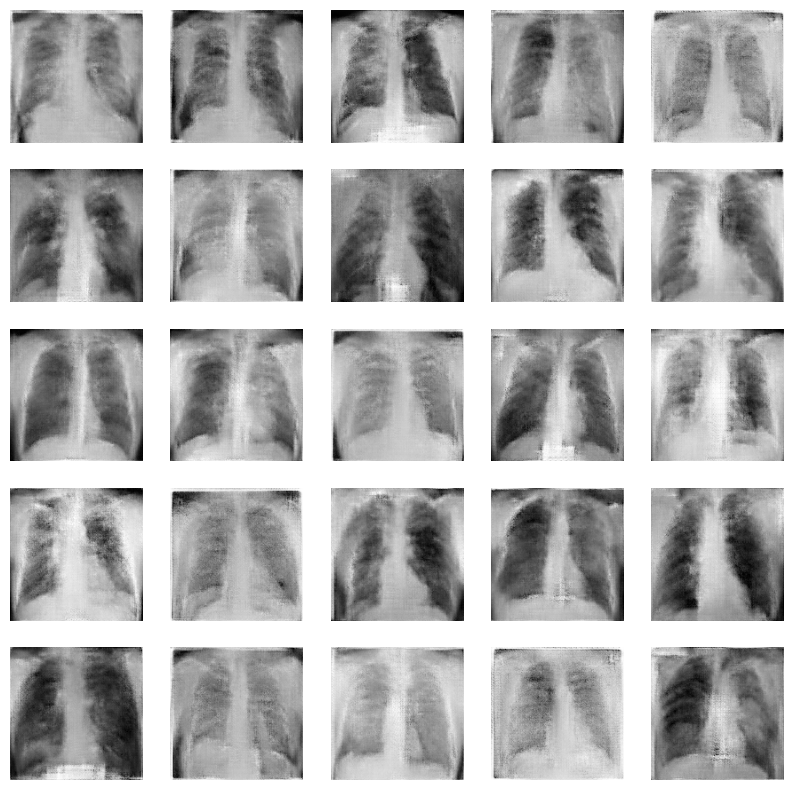

Epoch 231, Disc loss 0.24797147287366292, Generator loss 3.7202454109986625
Epoch 232, Disc loss 0.2651649763962875, Generator loss 3.666251798470815
Epoch 233, Disc loss 0.252429293623815, Generator loss 3.7203636964162192
Epoch 234, Disc loss 0.2501660809696962, Generator loss 3.8133413890997567
Epoch 235, Disc loss 0.25484637077897787, Generator loss 3.7767724096775055
Epoch 236, Disc loss 0.3178598356898874, Generator loss 3.787869950135549
Epoch 237, Disc loss 0.2687582012731582, Generator loss 3.687540431817373
Epoch 238, Disc loss 0.2605858369109531, Generator loss 3.6941706438859305
Epoch 239, Disc loss 0.248242666789641, Generator loss 3.7744641105333963
Epoch 240, Disc loss 0.2445095311074207, Generator loss 3.7882254918416343
1/1 [==============================] - 0s 26ms/step


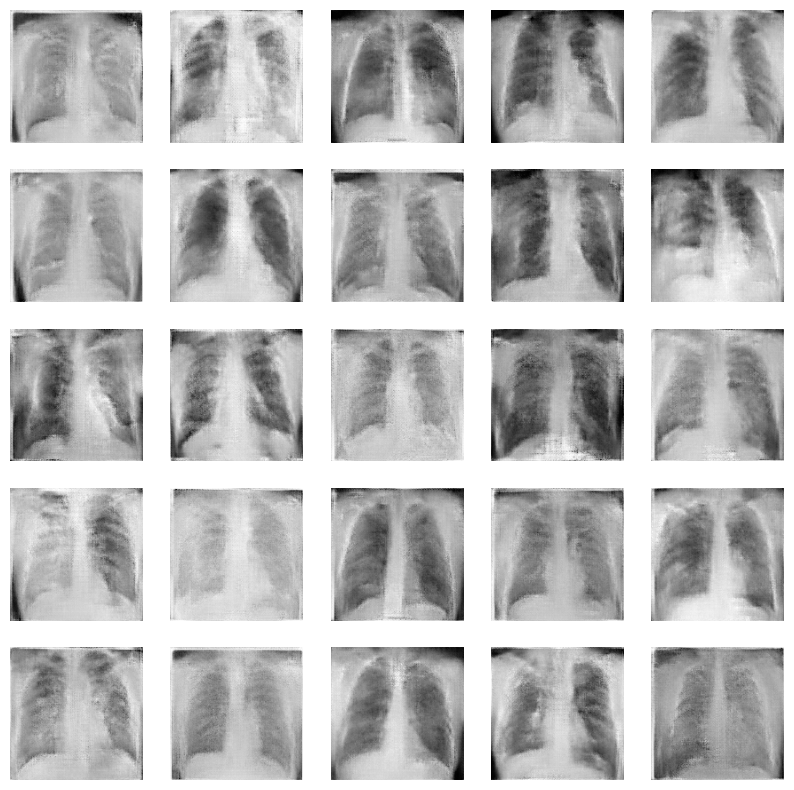

Epoch 241, Disc loss 0.24209203648691377, Generator loss 3.8420393963654837
Epoch 242, Disc loss 0.2778601989460488, Generator loss 3.863210548957189
Epoch 243, Disc loss 0.26590458769351244, Generator loss 3.9212507208188376
Epoch 244, Disc loss 0.3040427383966744, Generator loss 3.759616563717524
Epoch 245, Disc loss 0.24839704243155816, Generator loss 3.8317670822143555
Epoch 246, Disc loss 0.2528747187461704, Generator loss 3.879404882589976
Epoch 247, Disc loss 0.26903730576547485, Generator loss 3.838783929745356
Epoch 248, Disc loss 0.2532238796508561, Generator loss 3.976393461227417
Epoch 249, Disc loss 0.3043846134872486, Generator loss 3.932976951201757
Epoch 250, Disc loss 0.23884663761903843, Generator loss 3.947836697101593
1/1 [==============================] - 0s 22ms/step


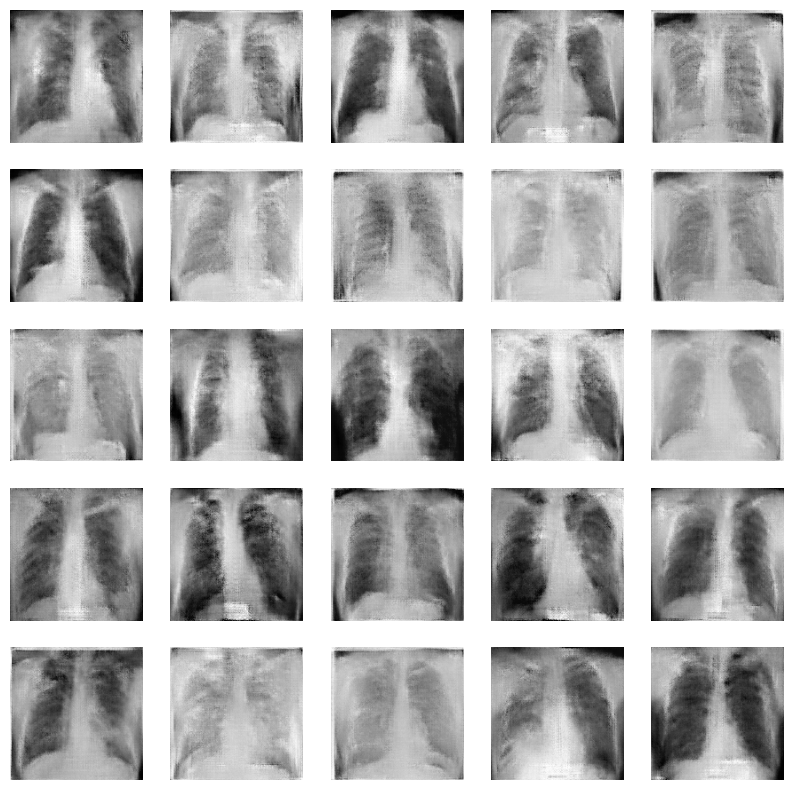

Epoch 251, Disc loss 0.24962019827216864, Generator loss 3.969915817181269
Epoch 252, Disc loss 0.2872546297342827, Generator loss 3.8536742329597473
Epoch 253, Disc loss 0.2584728034368406, Generator loss 3.9735515117645264
Epoch 254, Disc loss 0.2563683236173044, Generator loss 4.02918936808904
Epoch 255, Disc loss 0.29769605793990195, Generator loss 4.022441258033116
Epoch 256, Disc loss 0.270972302959611, Generator loss 3.905967950820923
Epoch 257, Disc loss 0.25761668547056615, Generator loss 3.984768162171046
Epoch 258, Disc loss 0.23396460401515165, Generator loss 3.9992414017518363
Epoch 259, Disc loss 0.25585682635816437, Generator loss 4.032302478949229
Epoch 260, Disc loss 0.2627954282021771, Generator loss 3.901777893304825
1/1 [==============================] - 0s 22ms/step


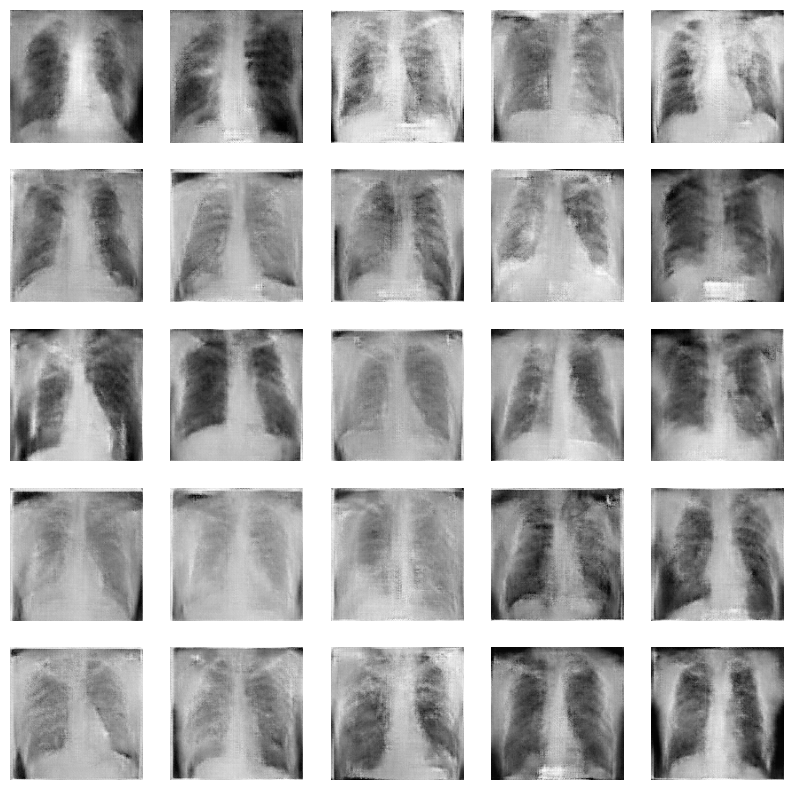

Epoch 261, Disc loss 0.25771718635223806, Generator loss 4.087537278731664
Epoch 262, Disc loss 0.26496286562178284, Generator loss 4.048147579034169
Epoch 263, Disc loss 0.22820351008946696, Generator loss 4.092595686515172
Epoch 264, Disc loss 0.23465807161604366, Generator loss 4.037216981252034
Epoch 265, Disc loss 0.2224201086598138, Generator loss 4.235802511374156
Epoch 266, Disc loss 0.23848185664974153, Generator loss 4.172030349572499
Epoch 267, Disc loss 0.31979141015714657, Generator loss 4.243176112572352
Epoch 268, Disc loss 0.24383375234901905, Generator loss 4.068032532930374
Epoch 269, Disc loss 0.26452265547898907, Generator loss 4.076764394839604
Epoch 270, Disc loss 0.24889927761008343, Generator loss 4.184978584448497
1/1 [==============================] - 0s 25ms/step


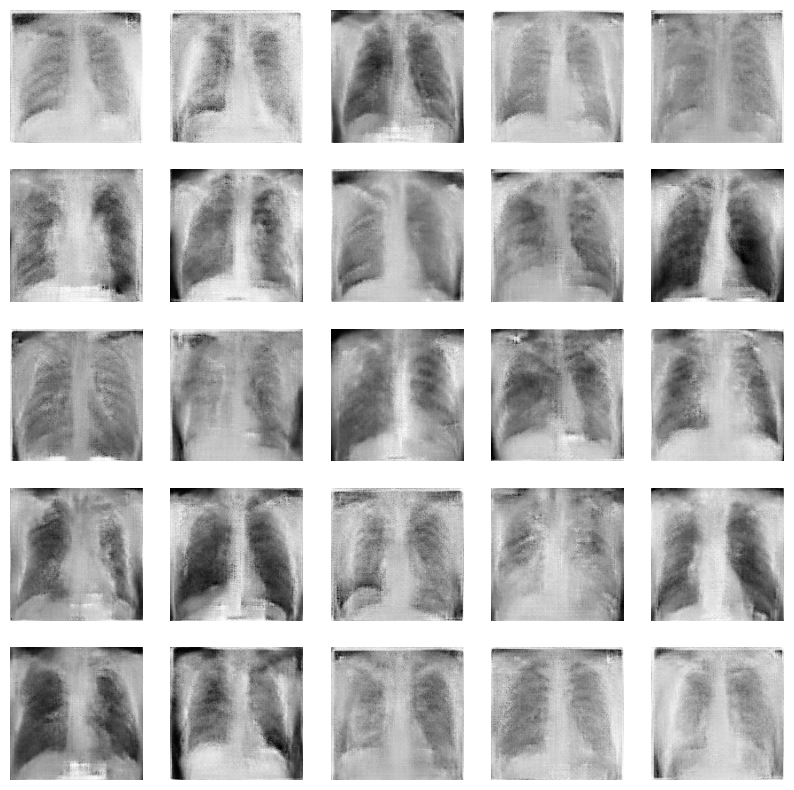

Epoch 271, Disc loss 0.2446293318644166, Generator loss 4.157087087631226
Epoch 272, Disc loss 0.2441045722613732, Generator loss 4.16744135816892
Epoch 273, Disc loss 0.2384479019480447, Generator loss 4.190900961558024
Epoch 274, Disc loss 0.2355813877269005, Generator loss 4.202115426460902
Epoch 275, Disc loss 0.25605377337584895, Generator loss 4.19383751352628
Epoch 276, Disc loss 0.2189876950190713, Generator loss 4.275023897488912
Epoch 277, Disc loss 0.22264483171359947, Generator loss 4.356117258469264
Epoch 278, Disc loss 0.23646113548117378, Generator loss 4.335079322258632
Epoch 279, Disc loss 0.3506539410445839, Generator loss 4.414525508880615
Epoch 280, Disc loss 0.22711702156811953, Generator loss 4.182709872722626
1/1 [==============================] - 0s 19ms/step


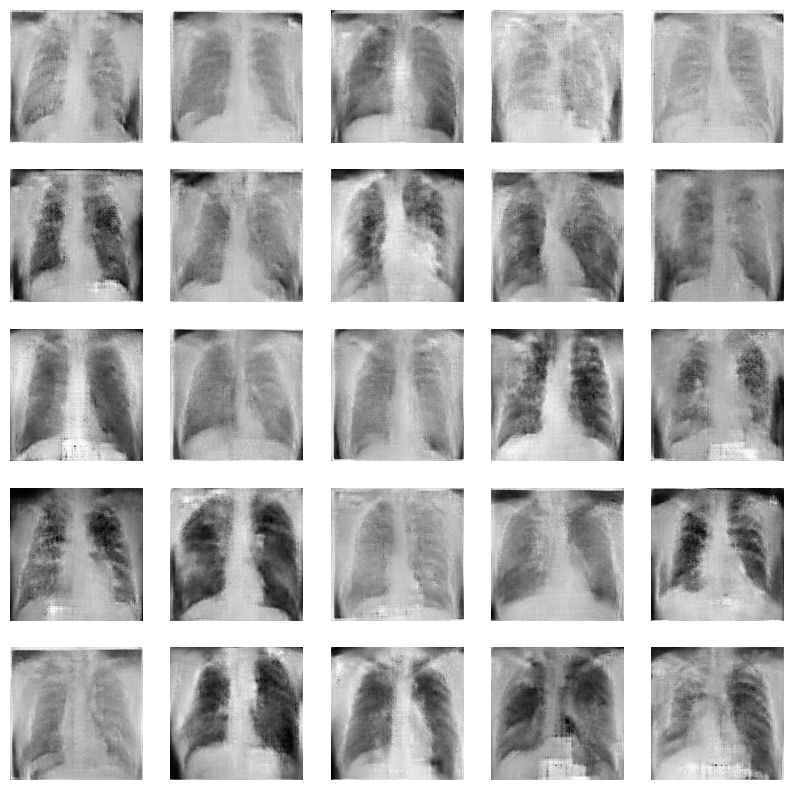

Epoch 281, Disc loss 0.21246825973503292, Generator loss 4.328727771838506
Epoch 282, Disc loss 0.2296680803022658, Generator loss 4.311427543560664
Epoch 283, Disc loss 0.2311231787704552, Generator loss 4.294276833534241
Epoch 284, Disc loss 0.24753900931682438, Generator loss 4.362979024648666
Epoch 285, Disc loss 0.23331837290121862, Generator loss 4.335622787475586
Epoch 286, Disc loss 0.22412993801602474, Generator loss 4.453066875537236
Epoch 287, Disc loss 0.22033141925930977, Generator loss 4.422859350840251
Epoch 288, Disc loss 0.2540613788102443, Generator loss 4.461499065160751
Epoch 289, Disc loss 0.2255611214398717, Generator loss 4.374129672845204
Epoch 290, Disc loss 0.3191031749593094, Generator loss 4.457632958889008
1/1 [==============================] - 0s 19ms/step


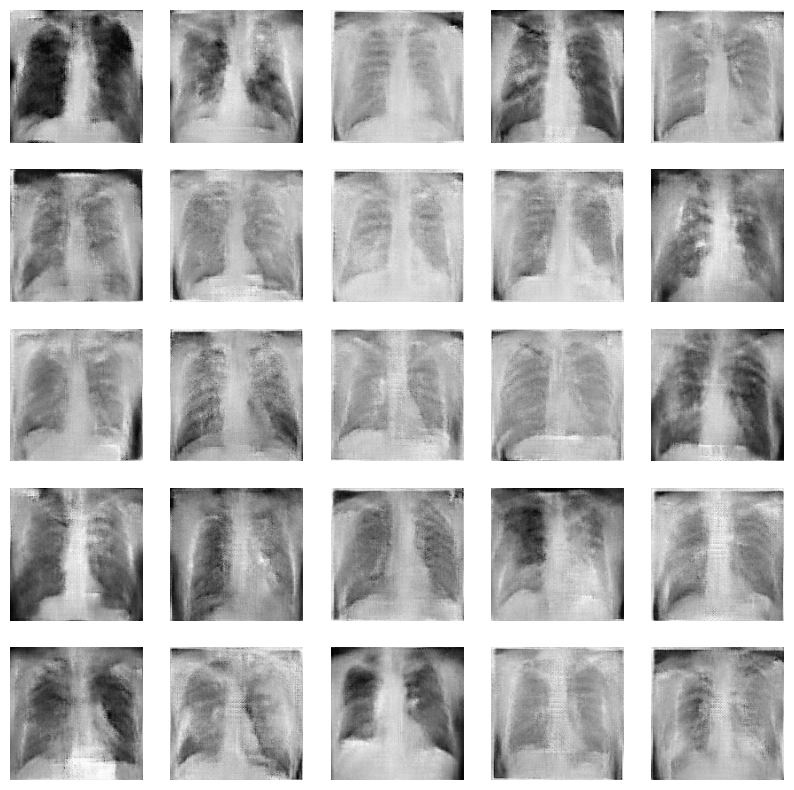

Epoch 291, Disc loss 0.262102814973332, Generator loss 4.279521157344182
Epoch 292, Disc loss 0.20929454911189774, Generator loss 4.416019380092621
Epoch 293, Disc loss 0.21990487747825682, Generator loss 4.483394354581833
Epoch 294, Disc loss 0.21218000313577554, Generator loss 4.552484532197316
Epoch 295, Disc loss 0.23203141457634047, Generator loss 4.52801255385081
Epoch 296, Disc loss 0.26453634704618406, Generator loss 4.36678762237231
Epoch 297, Disc loss 0.32373131237303215, Generator loss 4.443228254715602
Epoch 298, Disc loss 0.22715263856419673, Generator loss 4.407558858394623
Epoch 299, Disc loss 0.22957638162188232, Generator loss 4.4819415509700775
Epoch 300, Disc loss 0.22191348838775107, Generator loss 4.480354229609172
1/1 [==============================] - 0s 20ms/step


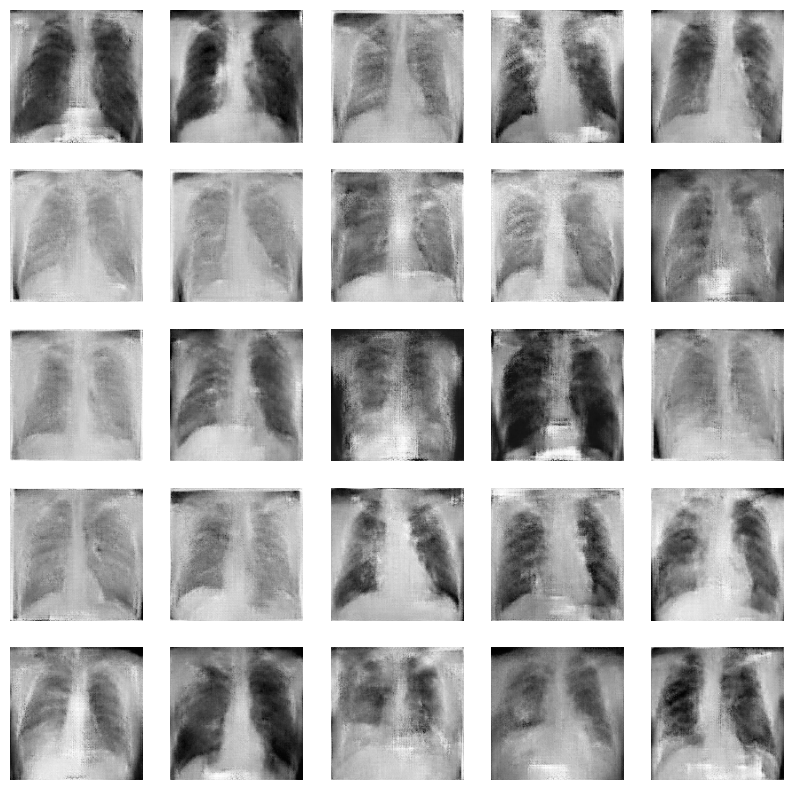

Epoch 301, Disc loss 0.2432233247285088, Generator loss 4.453867644071579
Epoch 302, Disc loss 0.21477016600935409, Generator loss 4.564362744490306
Epoch 303, Disc loss 0.21527130987184742, Generator loss 4.642829696337382
Epoch 304, Disc loss 0.34963456170711044, Generator loss 5.028383900721868
Epoch 305, Disc loss 0.3503648250868234, Generator loss 4.2869583169619245
Epoch 306, Disc loss 0.22549083060584962, Generator loss 4.26670902967453
Epoch 307, Disc loss 0.2114980718276153, Generator loss 4.4445584416389465
Epoch 308, Disc loss 0.21474103191091368, Generator loss 4.571202754974365
Epoch 309, Disc loss 0.20723710861057043, Generator loss 4.5685489773750305
Epoch 310, Disc loss 0.20488170763322464, Generator loss 4.603621184825897
1/1 [==============================] - 0s 20ms/step


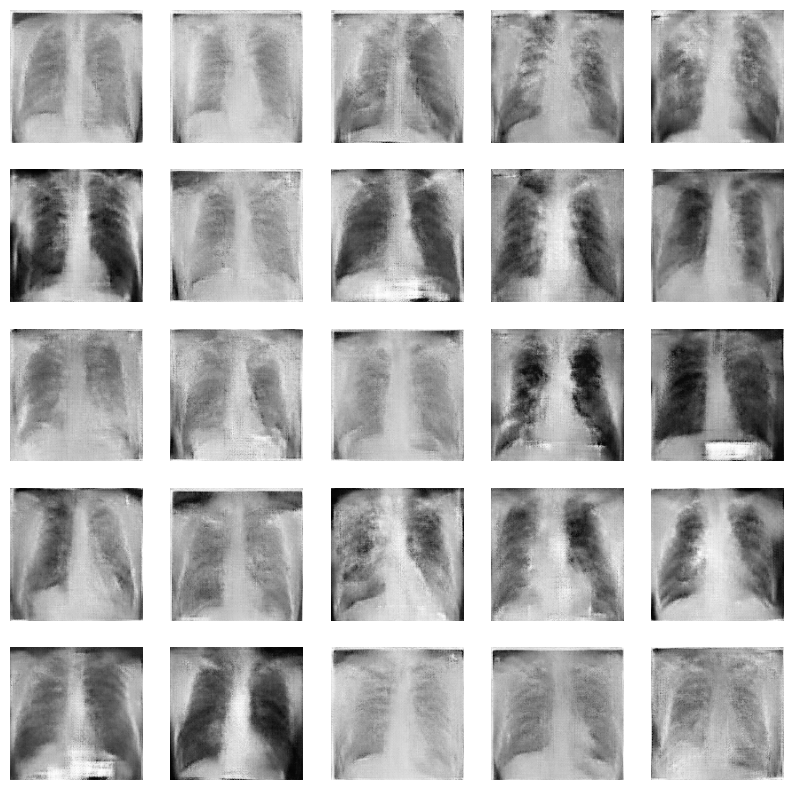

Epoch 311, Disc loss 0.2110327266079063, Generator loss 4.597301691770554
Epoch 312, Disc loss 0.2217570785433054, Generator loss 4.636017978191376
Epoch 313, Disc loss 0.20483634845974544, Generator loss 4.71783568461736
Epoch 314, Disc loss 0.21370068790080646, Generator loss 4.616315970818202
Epoch 315, Disc loss 0.20969649381004274, Generator loss 4.736528625090917
Epoch 316, Disc loss 0.2066801166317115, Generator loss 4.756522158781688
Epoch 317, Disc loss 0.23109713608088592, Generator loss 4.73881001273791
Epoch 318, Disc loss 0.21672764812440923, Generator loss 4.681146562099457
Epoch 319, Disc loss 0.19953471623981991, Generator loss 4.9006502230962115
Epoch 320, Disc loss 0.2034742399894943, Generator loss 4.756623645623525
1/1 [==============================] - 0s 21ms/step


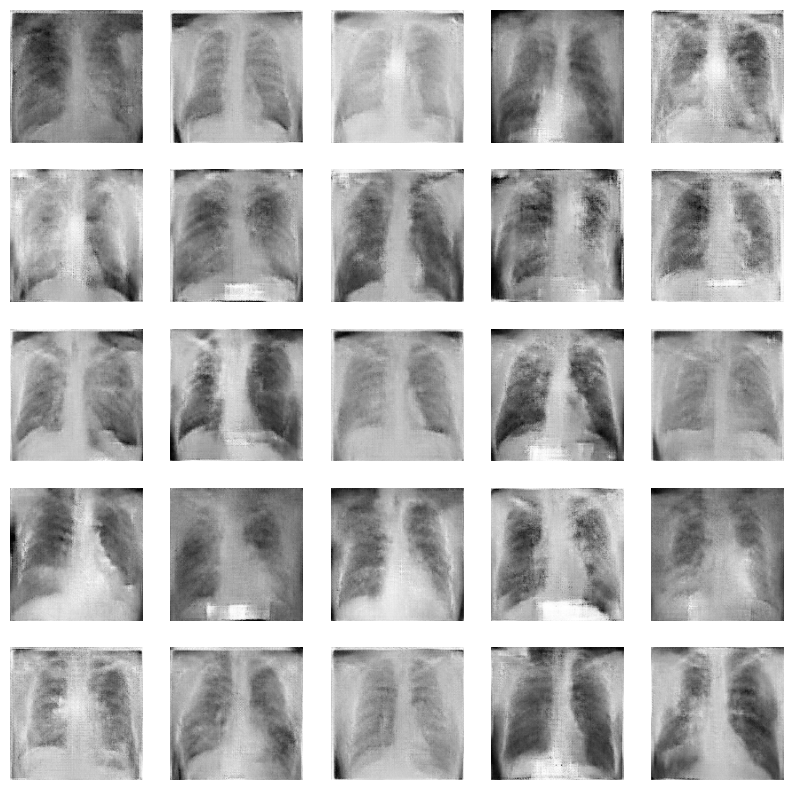

Epoch 321, Disc loss 0.25522764133832726, Generator loss 5.100358108679454
Epoch 322, Disc loss 0.23673625173978508, Generator loss 4.559422522783279
Epoch 323, Disc loss 0.199772717023734, Generator loss 4.766929964224498
Epoch 324, Disc loss 0.21509083298345408, Generator loss 4.766050746043523
Epoch 325, Disc loss 0.258551587156641, Generator loss 4.779747029145558
Epoch 326, Disc loss 0.2247867361875251, Generator loss 4.671867807706197
Epoch 327, Disc loss 0.2724011210569491, Generator loss 4.73248024781545
Epoch 328, Disc loss 0.20586113325164965, Generator loss 4.815805594126384
Epoch 329, Disc loss 0.229614919788825, Generator loss 4.923794547716777
Epoch 330, Disc loss 0.3375354763896515, Generator loss 4.854007035493851
1/1 [==============================] - 0s 20ms/step


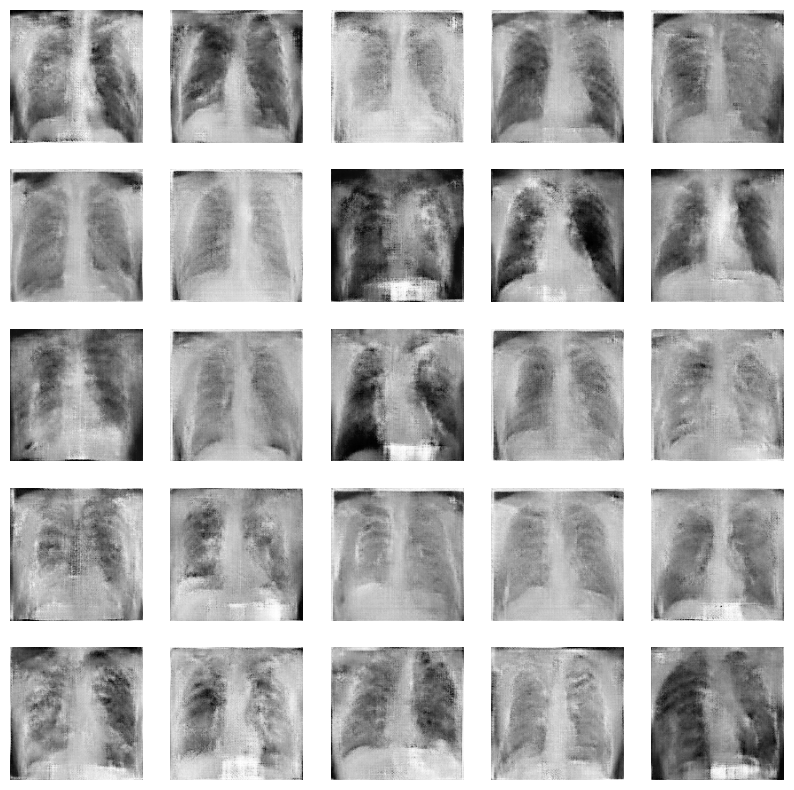

Epoch 331, Disc loss 0.2063333058031276, Generator loss 4.6544845799605055
Epoch 332, Disc loss 0.2094349181667591, Generator loss 4.804878731568654
Epoch 333, Disc loss 0.2033823827902476, Generator loss 4.913935114940007
Epoch 334, Disc loss 0.20659999801622084, Generator loss 4.791507840156555


KeyboardInterrupt: 

In [ ]:
gan = train(x_train_tuberculosis)

In [ ]:
import os
from PIL import Image
import zipfile

def generate_and_save_images(generator, noise_dim, samples=25, folder_name="generated_images"):
    # Create a folder for storing images in Colab
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)

    # Generate noise and predict images
    noise = np.random.normal(0, 1, size=(samples, noise_dim))
    generated_img = generator.predict(noise)

    # Save each generated image as a PNG
    for i in range(samples):
        img = (generated_img[i] * 255).astype(np.uint8)  # Scale to 0-255
        if img.shape[-1] == 1:  # Handle grayscale (if applicable)
            img = img.squeeze(-1)
        img = Image.fromarray(img)
        img.save(os.path.join(folder_name, f"image_{i+1}.png"))

    # Zip the folder
    zip_filename = f"{folder_name}.zip"
    with zipfile.ZipFile(zip_filename, 'w') as zipf:
        for root, _, files in os.walk(folder_name):
            for file in files:
                zipf.write(os.path.join(root, file), os.path.relpath(os.path.join(root, file), folder_name))

    print(f"Images saved in folder '{folder_name}' and zipped as '{zip_filename}'.")

# Create 2534 chest x ray images
generate_and_save_images(generator, noise_dim=100, samples=3225)

# To download the zip file manually in Colab
from google.colab import files
files.download("generated_images.zip")


In [ ]:
# Training Loop

#d_losses = []
#g_losses = []

#for epoch in range(total_epochs):
  #epoch_d_loss = 0.0
  #epoch_g_loss = 0.0

  # mini batch gd

  #for step in range(no_of_batches):

    # Train discriminator
    #discriminator.trainable = True
    #idx = np.random.randint(0,1341,half_batch)
    #real_imgs = x_train_normal[idx]

    #noise = np.random.normal(0,1,size=(half_batch,noise_dim))
    #fake_imgs = generator.predict(noise, verbose=0)

    #real_y = np.ones((half_batch,1))*0.9
    #fake_y = np.zeros((half_batch,1))

    #d_loss_real = discriminator.train_on_batch(real_imgs, real_y)
    #d_loss_fake = discriminator.train_on_batch(fake_imgs, fake_y)

    #d_loss = 0.5*d_loss_real + 0.5*d_loss_fake
    #epoch_d_loss += d_loss

    # Train generator

    #discriminator.trainable = False
    #noise = np.random.normal(0,1,size=(batch_size,noise_dim))
    #ground_truth_y = np.ones((batch_size,1))
    #g_loss = model.train_on_batch(noise,ground_truth_y,)
    #epoch_g_loss += g_loss

  #print(f"Epoch {epoch+1}, Disc loss {epoch_d_loss/no_of_batches}, Generator loss {epoch_g_loss/no_of_batches}")

  #d_losses.append(epoch_d_loss/no_of_batches)
  #g_losses.append(epoch_g_loss/no_of_batches)

  #if (epoch+1)%10 == 0:
    #generator.save("generator.h5")
    #display_images()